# **Introduction:**

The Conversation AI team, a research initiative founded by Jigsaw and Google (both part of Alphabet), builds technology to protect voices in conversation. Jigsaw extended annotations of this data by human raters for various toxic conversations and set a competition on kaggle to build ML/DL models to identify toxic comments.  

# **Business Problem**

The Conversation AI team initially had built models that classify comments with toxicity, but incorrectly learned to associate the names of frequently attacked identities with toxicity. Where toxicity is defined as anything rude, disrespectful or otherwise likely to make someone leave a discussion. The dataset also labels certain comments as bias/targeted towards certain identity, where the source of comment states it as toxic which is actually not - this the unintended bias. So our objective is to build a model that finds the toxic comments and minimize the unintended bias with respect to mentioned identities.

# **Evaluation Metric Usage and Explanation:**

Reference: https://www.kaggle.com/c/jigsaw-unintended-bias-in-toxicity-classification/overview/evaluation

For the competition they have considered a new metric which is the combination of different metrics to get the final metric.

**1. Bias AUCs:**

Divided into three catrgories each helps understand the aspects of unintended bias
*  ***Subgroup AUC:***
Focused on data set points which includes specific identity subgroup. The metric value determines the performance of model to distinguish between toxic and non-toxic comments which mentions the identity.

*   ***Background Positive,Subgroup Negative (BPSN):***
Focused on non-toxic comment dataset points which mention identity and toxic comment points without identity. A low value means that the model predicts higher toxicity scores than it should for non-toxic examples mentioning the identity.
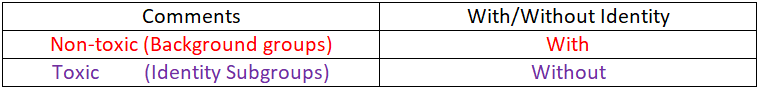
*   ***Background Negative,Subgroup Positive (BNSP):*** Focused on toxic comment dataset points which mention identity and non-toxic comment points without identity. A low value means that the model predicts lower toxicity scores than it should for toxic examples mentioning the identity.
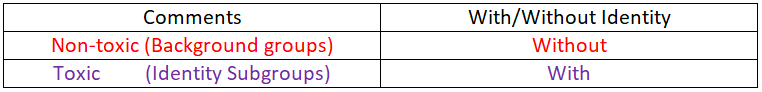

**2. Final Metric:**

We combine the overall AUC with the generalized mean of the Bias AUCs to calculate the final model score

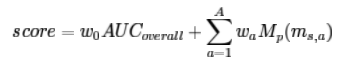

where:

A: Number of Submetrics
ms,a: bias metric for identity subgroup 's' using submetric 'a'
wa = 'a' weights for the relative importance of each submetric; all four 'w' values set to 0.25






# Importing Packages

In [ ]:
import os
import numpy as np
import re
import nltk
import pandas as pd
import pickle
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score
from tensorflow.keras.layers import Dense,Input,Activation,Concatenate,Conv1D,Embedding,MaxPool1D,Flatten,Dropout
from tensorflow.keras.models import Model,Sequential
from tensorflow.keras.callbacks import EarlyStopping
import tensorflow as tf
import datetime
from keras.preprocessing.text import Tokenizer
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from keras.preprocessing.sequence import pad_sequences
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
import pickle
import warnings
warnings.filterwarnings("ignore")
from sklearn.metrics import confusion_matrix, classification_report,roc_auc_score
from sklearn.metrics.classification import accuracy_score, log_loss
import seaborn as sns
from tqdm import tqdm
from scipy.sparse import csr_matrix
from scipy.sparse import hstack
from sklearn import metrics
from tensorflow.keras.utils import plot_model
from xgboost import XGBClassifier

In [ ]:
from sklearn.calibration import CalibratedClassifierCV
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.tree import DecisionTreeClassifier
from lightgbm import LGBMClassifier

# **1. Load Data**

**Train data**

In [ ]:
train_df=pd.read_csv('/content/drive/MyDrive/Work_files/Jigsaw_toxicity_classification/train.csv')
train_df.head()

,id,target,comment_text,severe_toxicity,obscene,identity_attack,insult,threat,asian,atheist,bisexual,black,buddhist,christian,female,heterosexual,hindu,homosexual_gay_or_lesbian,intellectual_or_learning_disability,jewish,latino,male,muslim,other_disability,other_gender,other_race_or_ethnicity,other_religion,other_sexual_orientation,physical_disability,psychiatric_or_mental_illness,transgender,white,created_date,publication_id,parent_id,article_id,rating,funny,wow,sad,likes,disagree,sexual_explicit,identity_annotator_count,toxicity_annotator_count
0,59848,0.000000,"This is so cool. It's like, 'would you want yo...",0.000000,0.0,0.000000,0.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015-09-29 10:50:41.987077+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
1,59849,0.000000,Thank you!! This would make my life a lot less...,0.000000,0.0,0.000000,0.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015-09-29 10:50:42.870083+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
2,59852,0.000000,This is such an urgent design problem; kudos t...,0.000000,0.0,0.000000,0.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015-09-29 10:50:45.222647+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
3,59855,0.000000,Is this something I'll be able to install on m...,0.000000,0.0,0.000000,0.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015-09-29 10:50:47.601894+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
4,59856,0.893617,haha you guys are a bunch of losers.,0.021277,0.0,0.021277,0.87234,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2015-09-29 10:50:48.488476+00,2,NaN,2006,rejected,0,0,0,1,0,0.0,4,47


**Test data**

In [ ]:
X_test=pd.read_csv('/content/drive/MyDrive/Work_files/Jigsaw_toxicity_classification/test.csv')
X_test.head()

,id,comment_text
0,7097320,[ Integrity means that you pay your debts.]\n\...
1,7097321,This is malfeasance by the Administrator and t...
2,7097322,@Rmiller101 - Spoken like a true elitist. But ...
3,7097323,"Paul: Thank you for your kind words. I do, in..."
4,7097324,Sorry you missed high school. Eisenhower sent ...


In [ ]:
print('train data shape:',train_df.shape)
print('test data shape:',X_test.shape)

train data shape: (1804874, 45)
test data shape: (97320, 2)


**1.2 Converting target column to binary (0,1)**

In [ ]:
train_df['target']=np.where(train_df['target'] >=0.5, 1, 0)
train_df.head()

,id,target,comment_text,severe_toxicity,obscene,identity_attack,insult,threat,asian,atheist,bisexual,black,buddhist,christian,female,heterosexual,hindu,homosexual_gay_or_lesbian,intellectual_or_learning_disability,jewish,latino,male,muslim,other_disability,other_gender,other_race_or_ethnicity,other_religion,other_sexual_orientation,physical_disability,psychiatric_or_mental_illness,transgender,white,created_date,publication_id,parent_id,article_id,rating,funny,wow,sad,likes,disagree,sexual_explicit,identity_annotator_count,toxicity_annotator_count
0,59848,0,"This is so cool. It's like, 'would you want yo...",0.000000,0.0,0.000000,0.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015-09-29 10:50:41.987077+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
1,59849,0,Thank you!! This would make my life a lot less...,0.000000,0.0,0.000000,0.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015-09-29 10:50:42.870083+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
2,59852,0,This is such an urgent design problem; kudos t...,0.000000,0.0,0.000000,0.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015-09-29 10:50:45.222647+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
3,59855,0,Is this something I'll be able to install on m...,0.000000,0.0,0.000000,0.00000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015-09-29 10:50:47.601894+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
4,59856,1,haha you guys are a bunch of losers.,0.021277,0.0,0.021277,0.87234,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2015-09-29 10:50:48.488476+00,2,NaN,2006,rejected,0,0,0,1,0,0.0,4,47


**1.3 Number of null values in each column**

In [ ]:
train_df.isnull().sum()

id                                           0
target                                       0
comment_text                                 0
severe_toxicity                              0
obscene                                      0
identity_attack                              0
insult                                       0
threat                                       0
asian                                  1399744
atheist                                1399744
bisexual                               1399744
black                                  1399744
buddhist                               1399744
christian                              1399744
female                                 1399744
heterosexual                           1399744
hindu                                  1399744
homosexual_gay_or_lesbian              1399744
intellectual_or_learning_disability    1399744
jewish                                 1399744
latino                                 1399744
male         

***Demographic Categories***

In [ ]:
ethnics=['asian','latino','black','white','other_race_or_ethnicity']
religions=['atheist','buddhist','hindu','jewish','muslim','christian','other_religion']
gender=['female', 'male','transgender','other_gender'] 
sexual_orientation = ['heterosexual','bisexual','homosexual_gay_or_lesbian','other_sexual_orientation']
disabilities = ['intellectual_or_learning_disability','physical_disability','psychiatric_or_mental_illness','other_disability']
reactions = ['funny','wow','sad','likes','disagree','sexual_explicit']

# **2. EDA**

**Dataframe for EDA**

In [ ]:
# Converting all identity categories to boolean(0,1)
for column in ['target']+ethnics+religions+gender+sexual_orientation+disabilities:
  train_df[column]=np.where(train_df[column] >=0.5, 1, 0)
eda_df=train_df
eda_df.head()

,id,target,comment_text,severe_toxicity,obscene,identity_attack,insult,threat,asian,atheist,bisexual,black,buddhist,christian,female,heterosexual,hindu,homosexual_gay_or_lesbian,intellectual_or_learning_disability,jewish,latino,male,muslim,other_disability,other_gender,other_race_or_ethnicity,other_religion,other_sexual_orientation,physical_disability,psychiatric_or_mental_illness,transgender,white,created_date,publication_id,parent_id,article_id,rating,funny,wow,sad,likes,disagree,sexual_explicit,identity_annotator_count,toxicity_annotator_count
0,59848,0,"This is so cool. It's like, 'would you want yo...",0.000000,0.0,0.000000,0.00000,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2015-09-29 10:50:41.987077+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
1,59849,0,Thank you!! This would make my life a lot less...,0.000000,0.0,0.000000,0.00000,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2015-09-29 10:50:42.870083+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
2,59852,0,This is such an urgent design problem; kudos t...,0.000000,0.0,0.000000,0.00000,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2015-09-29 10:50:45.222647+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
3,59855,0,Is this something I'll be able to install on m...,0.000000,0.0,0.000000,0.00000,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2015-09-29 10:50:47.601894+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4
4,59856,1,haha you guys are a bunch of losers.,0.021277,0.0,0.021277,0.87234,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2015-09-29 10:50:48.488476+00,2,NaN,2006,rejected,0,0,0,1,0,0.0,4,47


## **2.1 Pie Chart for Number of Toxic and Non-Toxic comments**

Number of toxic comments  144334 , ( 7.99690172277954 %)
Number of non-toxic comments  1660540 , ( 92.00309827722046 %)


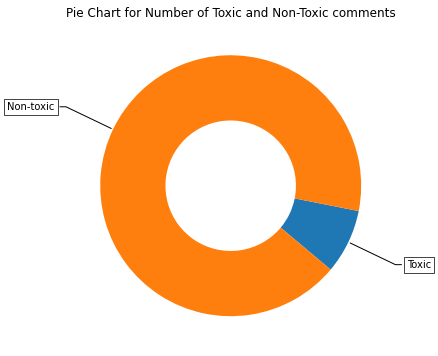

In [ ]:
# this code is taken from 
# https://matplotlib.org/gallery/pie_and_polar_charts/pie_and_donut_labels.html#sphx-glr-gallery-pie-and-polar-charts-pie-and-donut-labels-py
# reference from one of the assignments

y_value_counts = eda_df['target'].value_counts()
print("Number of toxic comments ", y_value_counts[1], ", (", (y_value_counts[1]/(y_value_counts[1]+y_value_counts[0]))*100,"%)")
print("Number of non-toxic comments ", y_value_counts[0], ", (", (y_value_counts[0]/(y_value_counts[1]+y_value_counts[0]))*100,"%)")

fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(aspect="equal"))
recipe = ["Toxic", "Non-toxic"]

data = [y_value_counts[1], y_value_counts[0]]

wedges, texts = ax.pie(data, wedgeprops=dict(width=0.5), startangle=-40)

bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
kw = dict(xycoords='data', textcoords='data', arrowprops=dict(arrowstyle="-"),
          bbox=bbox_props, zorder=0, va="center")

for i, p in enumerate(wedges):
    ang = (p.theta2 - p.theta1)/2. + p.theta1
    y = np.sin(np.deg2rad(ang))
    x = np.cos(np.deg2rad(ang))
    horizontalalignment = {-1: "right", 1: "left"}[int(np.sign(x))]
    connectionstyle = "angle,angleA=0,angleB={}".format(ang)
    kw["arrowprops"].update({"connectionstyle": connectionstyle})
    ax.annotate(recipe[i], xy=(x, y), xytext=(1.35*np.sign(x), 1.4*y),
                 horizontalalignment=horizontalalignment, **kw)

ax.set_title("Pie Chart for Number of Toxic and Non-Toxic comments")

plt.show()

## **2.2 Bar plot for number of Toxic and Non-toxic comments**

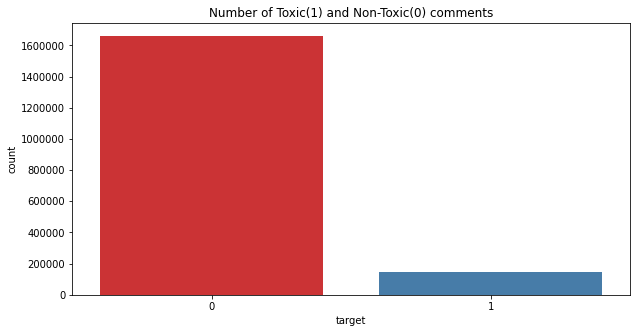

In [ ]:
fig = plt.figure(figsize=(10,5))
ax=sns.countplot(eda_df['target'],palette='Set1',)
ax.set_yticklabels([format(int(num)) for num in ax.get_yticks()])
plt.title('Number of Toxic(1) and Non-Toxic(0) comments')
plt.show()

**Observation:**
*   This dataset is highly imbalanced
*   Only 7.9% of Toxic comments are in the dataset



### **Adding a feature: number of unique words in each comment**

In [ ]:
uni_word_count=eda_df['comment_text'].apply(lambda x: len(set(w for w in x.split())))
eda_df['no_of_unique_words']=uni_word_count
eda_df.head()

,id,target,comment_text,severe_toxicity,obscene,identity_attack,insult,threat,asian,atheist,bisexual,black,buddhist,christian,female,heterosexual,hindu,homosexual_gay_or_lesbian,intellectual_or_learning_disability,jewish,latino,male,muslim,other_disability,other_gender,other_race_or_ethnicity,other_religion,other_sexual_orientation,physical_disability,psychiatric_or_mental_illness,transgender,white,created_date,publication_id,parent_id,article_id,rating,funny,wow,sad,likes,disagree,sexual_explicit,identity_annotator_count,toxicity_annotator_count,no_of_unique_words
0,59848,0,"This is so cool. It's like, 'would you want yo...",0.000000,0.0,0.000000,0.00000,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2015-09-29 10:50:41.987077+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4,19
1,59849,0,Thank you!! This would make my life a lot less...,0.000000,0.0,0.000000,0.00000,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2015-09-29 10:50:42.870083+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4,22
2,59852,0,This is such an urgent design problem; kudos t...,0.000000,0.0,0.000000,0.00000,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2015-09-29 10:50:45.222647+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4,16
3,59855,0,Is this something I'll be able to install on m...,0.000000,0.0,0.000000,0.00000,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2015-09-29 10:50:47.601894+00,2,NaN,2006,rejected,0,0,0,0,0,0.0,0,4,16
4,59856,1,haha you guys are a bunch of losers.,0.021277,0.0,0.021277,0.87234,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2015-09-29 10:50:48.488476+00,2,NaN,2006,rejected,0,0,0,1,0,0.0,4,47,8


## **2.3 Distribution of count of highest values in a row index for each attacked identity**

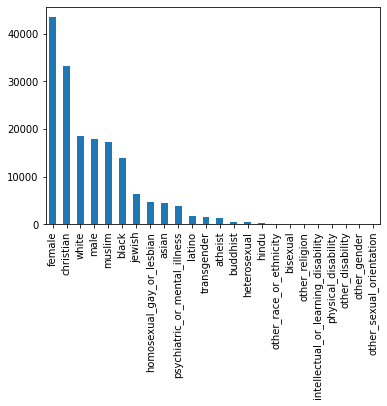

In [ ]:
# Concatinating all identities
identities_attacked=ethnics+religions+gender+disabilities+sexual_orientation

# using train_df for this step as we need the max value of a row.
df_id_count=pd.DataFrame()
df_id_count['idenities_count']=train_df[identities_attacked].replace(0, np.nan).idxmax(axis=1)
iden_count=df_id_count['idenities_count'].value_counts()
iden_count.plot.bar()

**Observation:**


*   This analysis helps us to know which identity is attacked more number of times in respect to other identities.
*   Females are the most number times targeted.
*   Gender, religion, ethnics are the demographic categories that are mostly attacked.





## **2.4 Plotting distributions for demographic categories**

In [ ]:
def distribution_plot(category,title):
  toxic_count=[]
  nontoxic_count=[]
  for col in category:
    nontoxic_count.append(eda_df.target.groupby(eda_df[col]).count()[0])
    toxic_count.append(eda_df.target.groupby(eda_df[col]).count()[1])
  temp_df=pd.DataFrame({'Toxic':toxic_count,'Non-Toxic':nontoxic_count},index=category)
  ax=temp_df.plot.bar(rot=15,subplots=True,figsize=(10,5))
  plt.title(title)
  print('toxic=',toxic_count)
  print('non-toxic=',nontoxic_count)

**Race or Ethnicity**

toxic= [4578, 2004, 14901, 25082, 508]
non-toxic= [1800296, 1802870, 1789973, 1779792, 1804366]


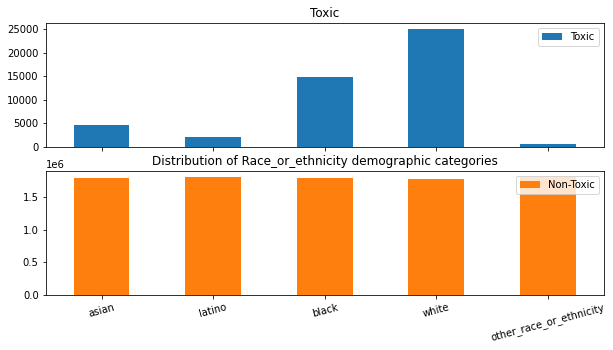

In [ ]:
distribution_plot(ethnics,'Distribution of Race_or_ethnicity demographic categories')

**Religions**

toxic= [1412, 588, 580, 7651, 21006, 40423, 325]
non-toxic= [1803462, 1804286, 1804294, 1797223, 1783868, 1764451, 1804549]


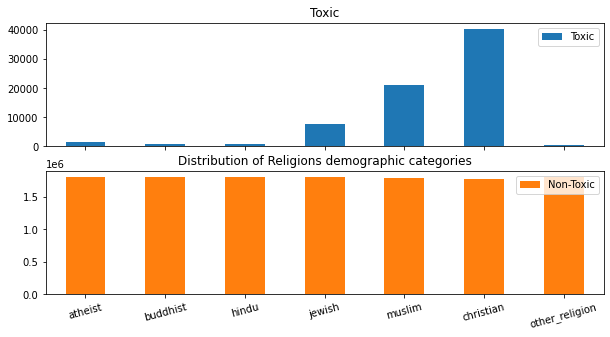

In [ ]:
distribution_plot(religions,'Distribution of Religions demographic categories')

**Gender**

toxic= [53429, 44484, 2499, 10]
non-toxic= [1751445, 1760390, 1802375, 1804864]


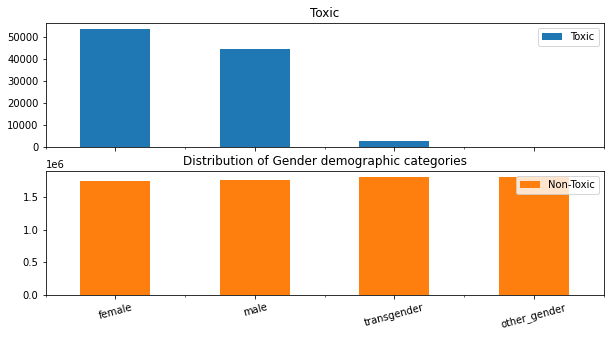

In [ ]:
distribution_plot(gender,'Distribution of Gender demographic categories')

**Sexual Orientation**

toxic= [1291, 287, 10997, 10]
non-toxic= [1803583, 1804587, 1793877, 1804864]


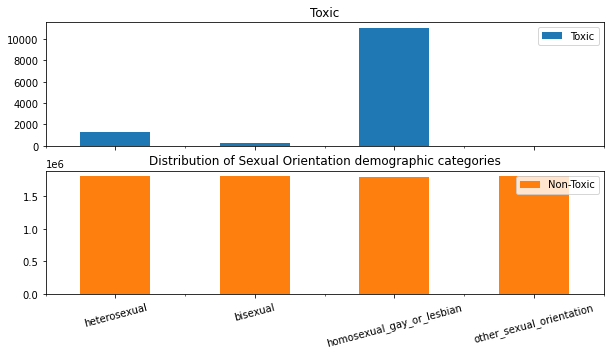

In [ ]:
distribution_plot(sexual_orientation,'Distribution of Sexual Orientation demographic categories')

**Disabilities**

toxic= [93, 82, 4889, 5]
non-toxic= [1804781, 1804792, 1799985, 1804869]


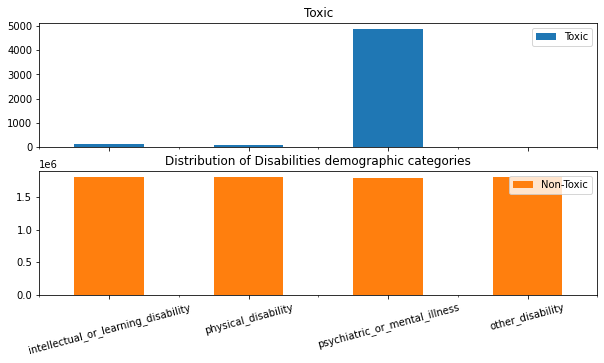

In [ ]:
distribution_plot(disabilities,'Distribution of Disabilities demographic categories')

**Observations:**


*   The above graphs provide the number of comments targeted towards a certain identity in each of the demographic categories.
*   This helps us to focus more on features which are more targeted in the comments among the categories.
*   The identities with large count and are also important are white, black , muslim, christian, male, female, homosexual_gay_or_lesbian and psychiatric_or_mental_illness







## **2.5 Box plot for number of unique words in each class.**

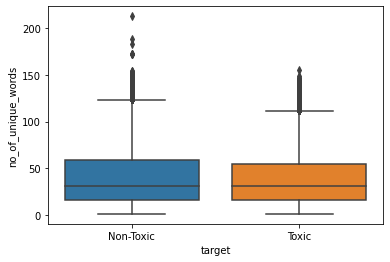

In [ ]:
tempdf=pd.DataFrame()
tempdf['target']=np.where(eda_df['target'] >=0.5, 'Toxic', 'Non-Toxic')
tempdf['no_of_unique_words']=eda_df['no_of_unique_words']
sns.boxplot(x = "target",y = 'no_of_unique_words',data=tempdf)

**Observations:**
*   For Non-Toxic plot
  1.   Maximum unique words is greater than 200
  2.   IQR ranges between 10-60

*   For Non-Toxic plot
  1.   Maximum unique words is greater than 150
  2.   IQR ranges between 10-50


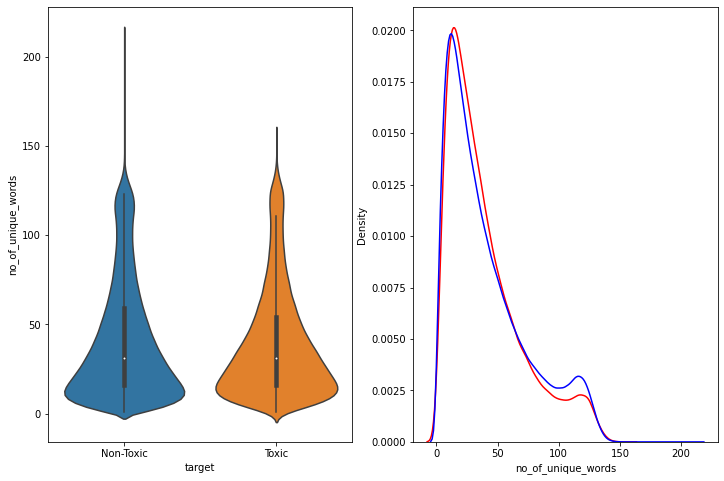

In [ ]:
plt.figure(figsize=(12, 8))

plt.subplot(1,2,1)
sns.violinplot(x = 'target', y = 'no_of_unique_words', data = tempdf)

plt.subplot(1,2,2)
sns.distplot(tempdf[tempdf['target'] == 'Toxic']['no_of_unique_words'] , label = "1", color = 'red',hist=False)
sns.distplot(tempdf[tempdf['target'] == 'Non-Toxic']['no_of_unique_words'] , label = "0" , color = 'blue' ,hist=False)
plt.show()

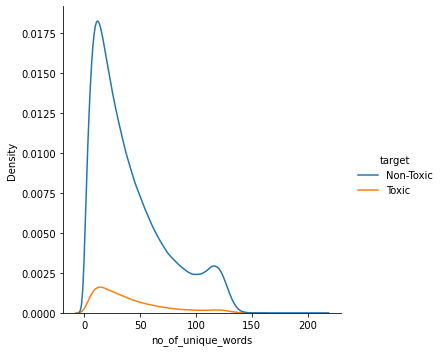

In [ ]:
sns.displot(data=tempdf, x="no_of_unique_words", hue="target", kind="kde")

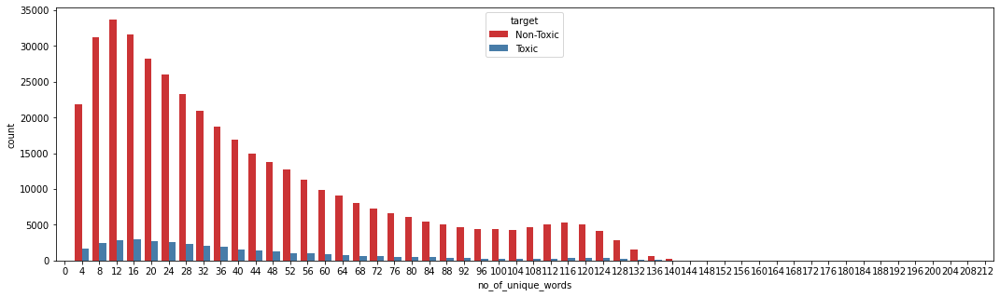

In [ ]:
fig,ax1 = plt.subplots(1,1, figsize = (18, 5))
o=np.arange(0,215,4)
sns.countplot(x='no_of_unique_words',hue='target',data=tempdf,palette='Set1',ax=ax1,order=o)

**Observation:**
*   From above graphs we can say that there are more comments with number of unique words in range of 1-50
*   There is slight bulge for Non-Toxic comments around 110-130, which indicates that Non-toxic comments have high number of unique words than Toxic comments. Thus this is significant feature for our analysis. 
*   As the graph also is almost overlapping, there is very small difference to classify for this number of unique words feature.






## **2.6 Word-Cloud Plot on Comment text data**

In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
import pandas as pd
  
# reference from one of the assignments
  


# iterate through the csv file
def wordcloud_display(data,title):
  comment_words = ''
  stopwords = set(STOPWORDS)
  for val in data:
        
      # typecaste each val to string
      val = str(val)
    
      # split the value
      tokens = val.split()
        
      # Converts each token into lowercase
      for i in range(len(tokens)):
          tokens[i] = tokens[i].lower()
        
      comment_words += " ".join(tokens)+" "
    
  wordcloud = WordCloud(width = 800, height = 800,
                  background_color ='white',
                  stopwords = stopwords,
                  min_font_size = 10).generate(comment_words)
    
  # plot the WordCloud image                       
  plt.figure(figsize = (8, 8), facecolor = None)
  plt.title(title)
  plt.imshow(wordcloud)
  plt.axis("off")
  plt.tight_layout(pad = 0)
    
  plt.show()

**Wordcloud for top toxic words in comments**

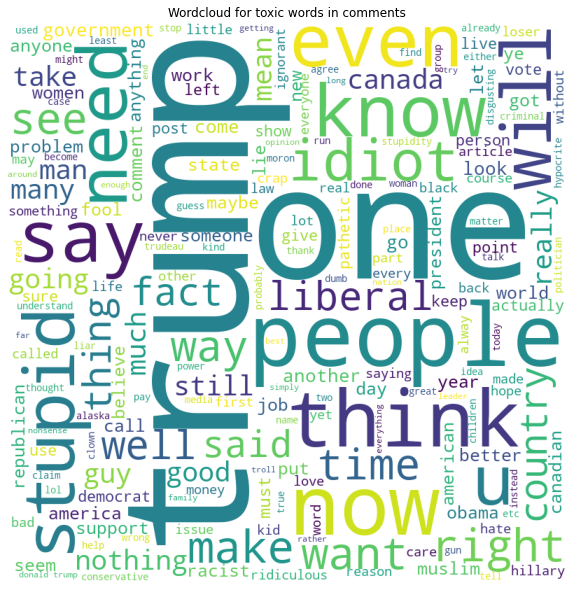

In [ ]:
toxic_comments=eda_df.loc[eda_df["target"] == 1, :]["comment_text"]
wordcloud_display(toxic_comments,'Wordcloud for toxic words in comments')

**Following are the WordClouds for finding words which are targeted to the most attacked identity from the demographic categories.**

***Ethnics***

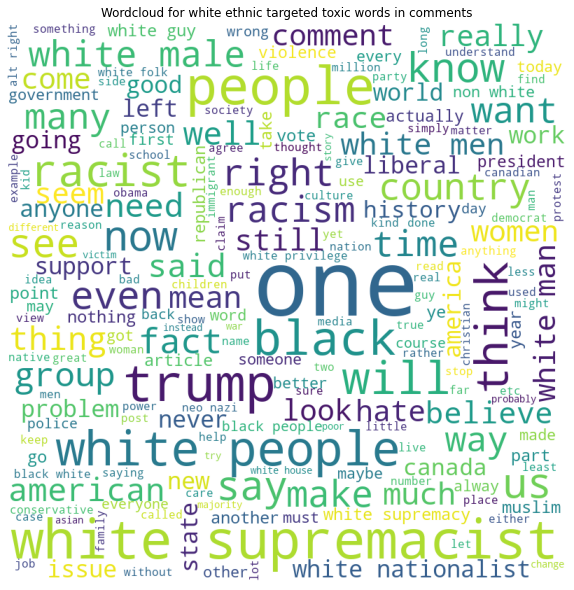

In [ ]:
# for white
white_toxic_words=eda_df.loc[eda_df["white"] == 1, :]["comment_text"]
wordcloud_display(white_toxic_words,'Wordcloud for white ethnic targeted toxic words in comments')

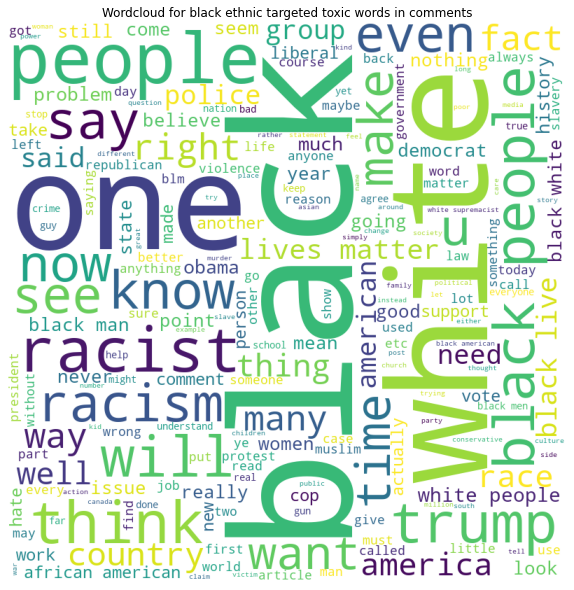

In [ ]:
# for black
black_toxic_words=eda_df.loc[eda_df["black"] == 1, :]["comment_text"]
wordcloud_display(black_toxic_words,'Wordcloud for black ethnic targeted toxic words in comments')

***Religion***

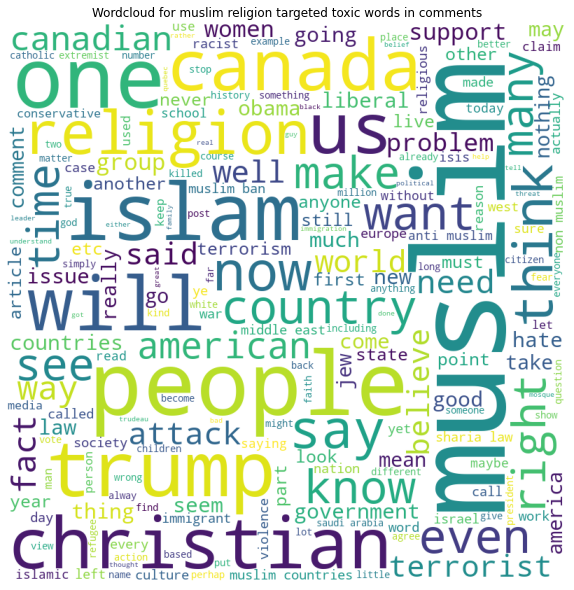

In [ ]:
# for muslim
muslim_toxic_words=eda_df.loc[eda_df["muslim"] == 1, :]["comment_text"]
wordcloud_display(muslim_toxic_words,'Wordcloud for muslim religion targeted toxic words in comments')

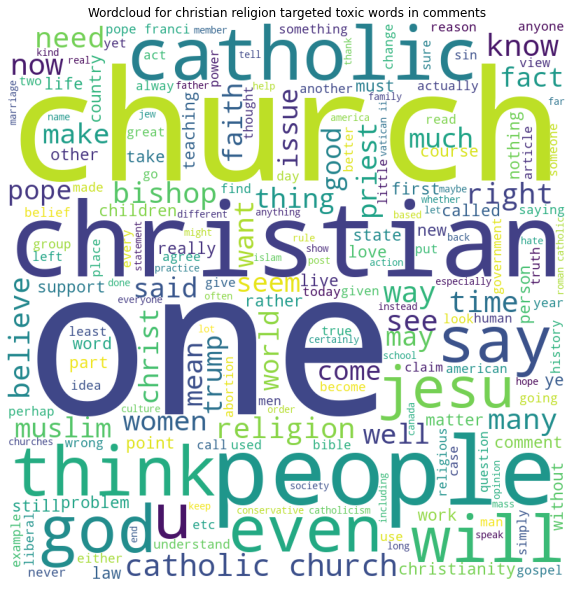

In [ ]:
# for christian
christian_toxic_words=eda_df.loc[eda_df["christian"] == 1, :]["comment_text"]
wordcloud_display(christian_toxic_words,'Wordcloud for christian religion targeted toxic words in comments')

***Gender***

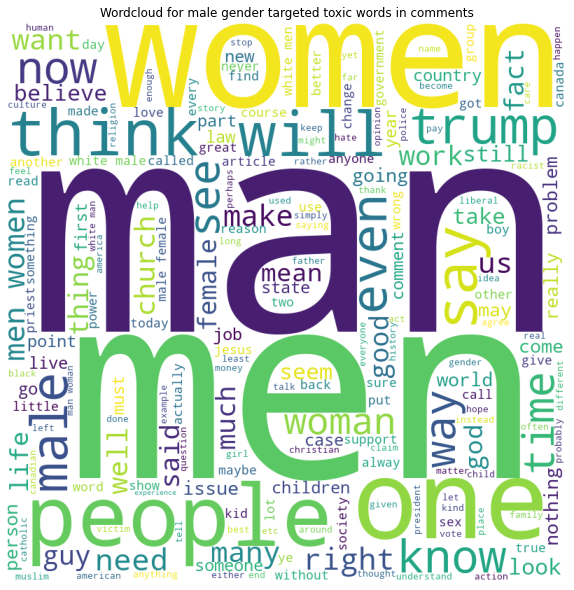

In [ ]:
# for male
male_toxic_words=eda_df.loc[eda_df["male"] == 1, :]["comment_text"]
wordcloud_display(male_toxic_words,'Wordcloud for male gender targeted toxic words in comments')

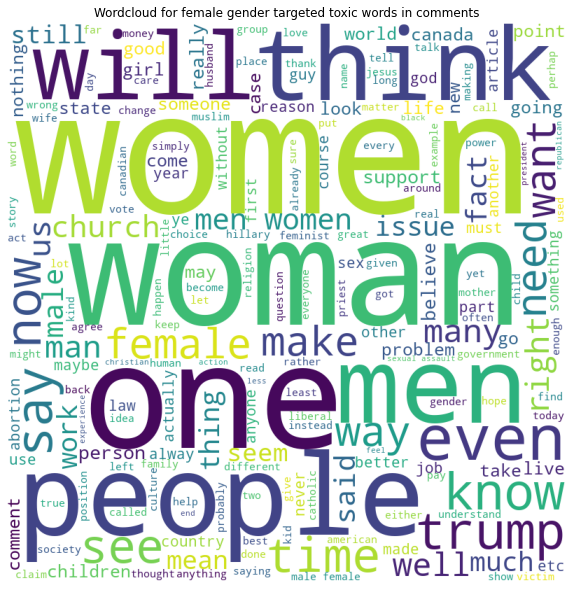

In [ ]:
# for female
female_toxic_words=eda_df.loc[eda_df["female"] == 1, :]["comment_text"]
wordcloud_display(female_toxic_words,'Wordcloud for female gender targeted toxic words in comments')

***Sexual orientation***

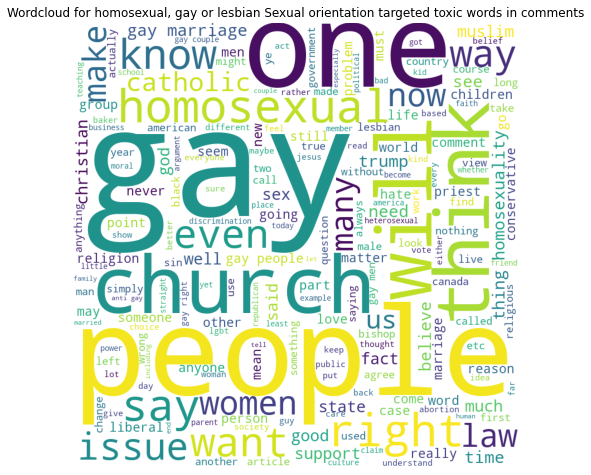

In [ ]:
# for homosexual_gay_or_lesbian
homosexual_gay_or_lesbian_toxic_words=eda_df.loc[eda_df["homosexual_gay_or_lesbian"] == 1, :]["comment_text"]
wordcloud_display(homosexual_gay_or_lesbian_toxic_words,'Wordcloud for homosexual, gay or lesbian Sexual orientation targeted toxic words in comments')

***Disabilities***

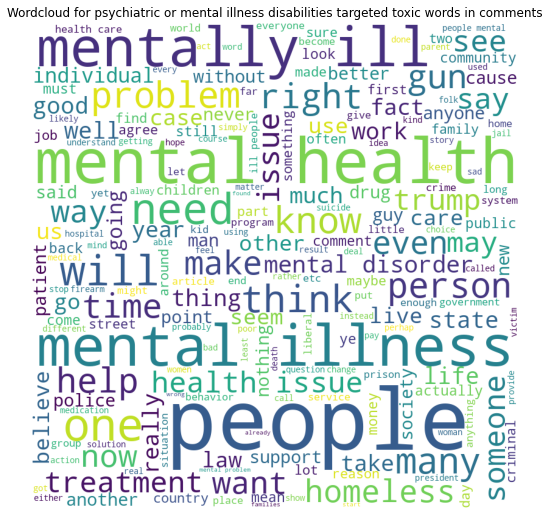

In [ ]:
# for psychiatric_or_mental_illness
psychiatric_or_mental_illness_toxic_words=eda_df.loc[eda_df["psychiatric_or_mental_illness"] == 1, :]["comment_text"]
wordcloud_display(psychiatric_or_mental_illness_toxic_words,'Wordcloud for psychiatric or mental illness disabilities targeted toxic words in comments')

# **3. Data Cleaning and Preprocessing**

**Considering only identity columns with more than 500 examples in the test set will be included for our classification**

In [ ]:
identity_columns=['male', 'female', 'homosexual_gay_or_lesbian','christian', 'jewish','muslim', 'black', 'white',
                  'psychiatric_or_mental_illness']
temp_cols=['id','comment_text']+identity_columns+['target']              
df=train_df[temp_cols]
df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,target
0,59848,"This is so cool. It's like, 'would you want yo...",0,0,0,0,0,0,0,0,0,0
1,59849,Thank you!! This would make my life a lot less...,0,0,0,0,0,0,0,0,0,0
2,59852,This is such an urgent design problem; kudos t...,0,0,0,0,0,0,0,0,0,0
3,59855,Is this something I'll be able to install on m...,0,0,0,0,0,0,0,0,0,0
4,59856,haha you guys are a bunch of losers.,0,0,0,0,0,0,0,0,0,1


In [ ]:
print('Number of null values in comment_text=',df['comment_text'].isnull().sum())

Number of null values in comment_text= 0


In [ ]:
y=df['target']
X=df.drop(columns=['target'],axis=1)

## **3.1 Split data into train and validation set**

In [ ]:
X_train, X_cv, y_train, y_cv = train_test_split(X, y, test_size=0.2, stratify=y)

Converting identity and target columns to boolean

In [ ]:
X_train['comment_text'].head()

369772     In reply to:\n\nSolar power has been around fo...
634793     Any party that thinks they can win\nwith carbo...
964708     I notice that he doesn't mention global warmin...
1061887    Now maybe Schumer will make an effort to be ci...
1020920    Im not sure if people are being willfully igno...
Name: comment_text, dtype: object

## **3.2 Preprocessing**

**Steps in Processing**

*   Decontracting words like won't to will not
*   Removing Stopwords
*   Removing Special characters
*   Removing unnecessary
*   Removing Rare words which occurs once.


In [ ]:
# https://stackoverflow.com/a/47091490/4084039
import re

def decontracted(phrase):
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

In [ ]:
# https://gist.github.com/sebleier/554280
# we are removing the words from the stop words list: 'no', 'nor', 'not'
stopwords= ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've",\
            "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', \
            'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their',\
            'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', \
            'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', \
            'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', \
            'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after',\
            'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further',\
            'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more',\
            'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', \
            's', 't', 'can', 'will', 'just', 'don', "don't", 'should', "should've", 'now', 'd', 'll', 'm', 'o', 're', \
            've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 'didn', "didn't", 'doesn', "doesn't", 'hadn',\
            "hadn't", 'hasn', "hasn't", 'haven', "haven't", 'isn', "isn't", 'ma', 'mightn', "mightn't", 'mustn',\
            "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", 'wasn', "wasn't", 'weren', "weren't", \
            'won', "won't", 'wouldn', "wouldn't"]

In [ ]:

def preprocess_text(text_data):
    preprocessed_text = []
    # tqdm is for printing the status bar
    for sentance in tqdm(text_data):
        sent = decontracted(sentance)
        sent = sent.replace('\\r', ' ')
        sent = sent.replace('\\n', ' ')
        sent = sent.replace('\\"', ' ')
        sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
        # https://gist.github.com/sebleier/554280
        sent = ' '.join(e for e in sent.split() if e.lower() not in stopwords)
        preprocessed_text.append(sent.lower().strip())
    return preprocessed_text

In [ ]:
X_train['comment_text']=preprocess_text(X_train['comment_text'])
X_cv['comment_text']=preprocess_text(X_cv['comment_text'])
X_train['comment_text'].head()

100%|██████████| 360975/360975 [00:50<00:00, 7153.40it/s]


369772     reply solar power around 70 years great would ...
634793     party thinks win carbon taxes dreaming climate...
964708     notice not mention global warming presume need...
1061887    maybe schumer make effort civil likely never h...
1020920    im not sure people willfully ignorant experien...
Name: comment_text, dtype: object

In [ ]:
X_test['comment_text']=preprocess_text(X_test['comment_text'])
X_test['comment_text'].head()

100%|██████████| 97320/97320 [00:13<00:00, 7144.50it/s]


0      integrity means pay debts apply president trump
1        malfeasance administrator board wasting money
2    rmiller101 spoken like true elitist look bud a...
3    paul thank kind words indeed strong beliefs no...
4    sorry missed high school eisenhower sent troop...
Name: comment_text, dtype: object

### **3.2.1 Removing Rare words**

In [ ]:
# Code reference from: https://www.kaggle.com/devchauhan1/twitter-sentiment-analysis-multinomialnb-lstm
rare_words= pd.Series(' '.join(X_train['comment_text']).split()).value_counts()[-20:]
rare_words

bailie             1
cliniclegal        1
extrapolative      1
stanadard          1
fragkisko          1
attr               1
trumpocalyps       1
wouldisruption     1
dtv                1
empoys             1
sighters           1
betc               1
indolents          1
roninmoron         1
traditionalrich    1
9king              1
scotchgard         1
solidworks         1
courtisy           1
sociologyguide     1
dtype: int64

In [ ]:
def rare_words_removal(dataf):
    dataf['comment_text'] = dataf['comment_text'].apply(lambda x: " ".join(x for x in x.split() if x not in rare_words))
    print(dataf['comment_text'].head())

In [ ]:
rare_words_removal(X_train)
rare_words_removal(X_cv)
rare_words_removal(X_test)

369772     reply solar power around 70 years great would ...
634793     party thinks win carbon taxes dreaming climate...
964708     notice not mention global warming presume need...
1061887    maybe schumer make effort civil likely never h...
1020920    im not sure people willfully ignorant experien...
Name: comment_text, dtype: object
171378    welcome ignorant like writing eleven mind numb...
848456    freeland really want side isis ones killed 80 ...
844586                       said one greatest not greatest
994839                  frivolous waste taxpayer time money
95901     unfortunately natives come across childish wan...
Name: comment_text, dtype: object
0      integrity means pay debts apply president trump
1        malfeasance administrator board wasting money
2    rmiller101 spoken like true elitist look bud a...
3    paul thank kind words indeed strong beliefs no...
4    sorry missed high school eisenhower sent troop...
Name: comment_text, dtype: object


## **3.3 Advanced features from text data**

***Top 20k toxic words***

In [ ]:
temp_tdf=X_train.copy()
temp_tdf['target']=y_train
toxic_comments=temp_tdf.loc[temp_tdf["target"] == 1, :]["comment_text"]
toxic_words=[word for word in list((toxic_comments.str.split(' ', expand=True).stack().value_counts()).index) if word not in STOPWORDS][:10000]
len(toxic_words)


10000

In [ ]:
def toxic_word_count(text_data):
  toxic_words_lst=[]
  for doc in text_data:
    count=0
    for w in doc.split():
      if w in toxic_words:
        count+=1
    toxic_words_lst.append(count)
  return toxic_words_lst
split_X_train=np.array_split(X_train['comment_text'], 5)
no_of_toxic_words=[]
for seq in tqdm(split_X_train):
  no_of_toxic_words+=toxic_word_count(seq)


100%|██████████| 5/5 [51:29<00:00, 617.91s/it]


In [ ]:
no_of_toxic_words_df=pd.read_csv('/content/drive/MyDrive/Work_files/Jigsaw_toxicity_classification/toxic_words_count.csv')

In [ ]:
#Train data
# Adding a feature: number of unique words in comments just like eda_df dataframe
uni_word_count=X_train['comment_text'].apply(lambda x: len(set(w for w in x.split())))
X_train['no_of_unique_words']=uni_word_count

#Adding number of words in a comment feature
no_of_words=X_train['comment_text'].str.split(' ').str.len()
X_train['word_count']=no_of_words

#Adding number of toxic words from the top toxic words count
X_train['toxic_words_count']=no_of_toxic_words
#Validation data
# Adding a feature: number of unique words in comments just like eda_df dataframe
uni_word_count=X_cv['comment_text'].apply(lambda x: len(set(w for w in x.split())))
X_cv['no_of_unique_words']=uni_word_count

no_of_words=X_cv['comment_text'].str.split(' ').str.len()
X_cv['word_count']=no_of_words

no_of_toxic_words=toxic_word_count(X_cv['comment_text'])
X_cv['toxic_words_count']=no_of_toxic_words


In [ ]:
X_train.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count
369772,695670,reply solar power around 70 years great would ...,0,0,0,0,0,0,0,0,0,52,66,54
634793,1018342,party thinks win carbon taxes dreaming climate...,0,0,0,0,0,0,0,0,0,43,45,41
964708,5298193,notice not mention global warming presume need...,0,0,0,0,0,0,0,0,0,21,24,21
1061887,5414705,maybe schumer make effort civil likely never h...,0,0,0,0,0,0,0,0,0,11,11,11
1020920,5365732,im not sure people willfully ignorant experien...,1,1,0,0,0,0,1,1,0,68,80,64


In [ ]:
X_cv.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count
171378,451469,welcome ignorant like writing eleven mind numb...,0,0,0,0,0,0,0,0,0,9,9,6
848456,5158745,freeland really want side isis ones killed 80 ...,0,0,0,0,0,0,0,0,0,27,28,25
844586,5154342,said one greatest not greatest,0,0,0,0,0,0,0,0,0,4,5,4
994839,5334288,frivolous waste taxpayer time money,0,0,0,0,0,0,0,0,0,5,5,5
95901,359629,unfortunately natives come across childish wan...,0,0,0,0,0,0,0,0,0,25,28,24


In [ ]:
# pickle.dump((X_train, y_train),open('/content/drive/MyDrive/Work_files/Jigsaw_toxicity_classification/train_npdata.pkl','wb'))
# pickle.dump((X_cv, y_cv),open('/content/drive/MyDrive/Work_files/Jigsaw_toxicity_classification/cv_npdata.pkl','wb'))

In [ ]:
X_train, y_train = pickle.load(open("/content/drive/MyDrive/Work_files/Jigsaw_toxicity_classification/train_npdata.pkl", 'rb')) 
X_cv, y_cv = pickle.load(open("/content/drive/MyDrive/Work_files/Jigsaw_toxicity_classification/cv_npdata.pkl", 'rb')) 
X_test = pickle.load(open("/content/drive/MyDrive/Work_files/Jigsaw_toxicity_classification/test_pdata.pkl", 'rb')) 

# **Important Functions**

In [ ]:
# Reference: https://www.kaggle.com/dborkan/benchmark-kernel
SUBGROUP_AUC = 'subgroup_auc'
BPSN_AUC = 'bpsn_auc'  # stands for background positive, subgroup negative
BNSP_AUC = 'bnsp_auc'  # stands for background negative, subgroup positive

def compute_auc(y_true, y_pred):
    try:
        return metrics.roc_auc_score(y_true, y_pred)
    except ValueError:
        return np.nan

def compute_subgroup_auc(df, subgroup, label, model_name):
    subgroup_examples = df[df[subgroup]]
    return compute_auc(subgroup_examples[label], subgroup_examples[model_name])

def compute_bpsn_auc(df, subgroup, label, model_name):
    """Computes the AUC of the within-subgroup negative examples and the background positive examples."""
    subgroup_negative_examples = df[df[subgroup] & ~df[label]]
    non_subgroup_positive_examples = df[~df[subgroup] & df[label]]
    examples = subgroup_negative_examples.append(non_subgroup_positive_examples)
    return compute_auc(examples[label], examples[model_name])

def compute_bnsp_auc(df, subgroup, label, model_name):
    """Computes the AUC of the within-subgroup positive examples and the background negative examples."""
    subgroup_positive_examples = df[df[subgroup] & df[label]]
    non_subgroup_negative_examples = df[~df[subgroup] & ~df[label]]
    examples = subgroup_positive_examples.append(non_subgroup_negative_examples)
    return compute_auc(examples[label], examples[model_name])

def compute_bias_metrics_for_model(dataset,
                                   subgroups,
                                   model,
                                   label_col,
                                   include_asegs=False):
    """Computes per-subgroup metrics for all subgroups and one model."""
    records = []
    for subgroup in subgroups:
        record = {
            'subgroup': subgroup,
            'subgroup_size': len(dataset[dataset[subgroup]])
        }
        record[SUBGROUP_AUC] = compute_subgroup_auc(dataset, subgroup, label_col, model)
        record[BPSN_AUC] = compute_bpsn_auc(dataset, subgroup, label_col, model)
        record[BNSP_AUC] = compute_bnsp_auc(dataset, subgroup, label_col, model)
        records.append(record)
    return pd.DataFrame(records).sort_values('subgroup_auc', ascending=True)


In [ ]:
def calculate_overall_auc(df, model_name):
    true_labels = df[TOXICITY_COLUMN]
    predicted_labels = df[model_name]
    return metrics.roc_auc_score(true_labels, predicted_labels)

def power_mean(series, p):
    total = sum(np.power(series, p))
    return np.power(total / len(series), 1 / p)

def get_final_metric(bias_df, overall_auc, POWER=-5, OVERALL_MODEL_WEIGHT=0.25):
    bias_score = np.average([
        power_mean(bias_df[SUBGROUP_AUC], POWER),
        power_mean(bias_df[BPSN_AUC], POWER),
        power_mean(bias_df[BNSP_AUC], POWER)
    ])
    return (OVERALL_MODEL_WEIGHT * overall_auc) + ((1 - OVERALL_MODEL_WEIGHT) * bias_score)
    


In [ ]:
def plot_confusion_matrix(test_y, predict_y):
    C = confusion_matrix(test_y, predict_y)
    # C = 9,9 matrix, each cell (i,j) represents number of points of class i are predicted class j
    
    A =(((C.T)/(C.sum(axis=1))).T)
    #divid each element of the confusion matrix with the sum of elements in that column
    
    # C = [[1, 2],
    #     [3, 4]]
    # C.T = [[1, 3],
    #        [2, 4]]
    # C.sum(axis = 1)  axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =1) = [[3, 7]]
    # ((C.T)/(C.sum(axis=1))) = [[1/3, 3/7]
    #                           [2/3, 4/7]]

    # ((C.T)/(C.sum(axis=1))).T = [[1/3, 2/3]
    #                           [3/7, 4/7]]
    # sum of row elements = 1
    
    B =(C/C.sum(axis=0))
    #divid each element of the confusion matrix with the sum of elements in that row
    # C = [[1, 2],
    #     [3, 4]]
    # C.sum(axis = 0)  axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =0) = [[4, 6]]
    # (C/C.sum(axis=0)) = [[1/4, 2/6],
    #                      [3/4, 4/6]] 
    plt.figure(figsize=(20,4))
    
    labels = [0,1]
    # representing A in heatmap format
    cmap=sns.light_palette("blue")
    plt.subplot(1, 3, 1)
    sns.heatmap(C, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Confusion matrix")
    
    plt.subplot(1, 3, 2)
    sns.heatmap(B, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Precision matrix")
    
    plt.subplot(1, 3, 3)
    # representing B in heatmap format
    sns.heatmap(A, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Recall matrix")
    
    plt.show()

def get_all_metrics(y,y_pred):
  print('Confusion Matrix:')
  print(plot_confusion_matrix(y, y_pred))
  print('Classification Report:')
  print(classification_report(y,y_pred))
  print('ROC-AUC Score:')
  print(roc_auc_score(y,y_pred))

In [ ]:
identity_columns = ['male', 'female', 'homosexual_gay_or_lesbian', 'christian', 'jewish',
    'muslim', 'black', 'white', 'psychiatric_or_mental_illness']

In [ ]:
# Reference: https://www.kaggle.com/dborkan/benchmark-kernel
MAX_NUM_WORDS = 10000
TOXICITY_COLUMN = 'target'
TEXT_COLUMN = 'comment_text'
MODEL_NAME = 'my_model'
DL_Model_name='dl_model'
# Create a text tokenizer.
tokenizer = Tokenizer(num_words=MAX_NUM_WORDS)
tokenizer.fit_on_texts(X_train[TEXT_COLUMN])

MAX_SEQUENCE_LENGTH = 310
def pad_text(texts, tokenizer):
    return pad_sequences(tokenizer.texts_to_sequences(texts), maxlen=MAX_SEQUENCE_LENGTH)

In [ ]:
def dataframe_for_metric(model,data):
  cv_df=X_cv.copy()
  MODEL_NAME = 'my_model'
  cv_df[MODEL_NAME] = model.predict_proba(data)[:, 1]
  cv_df['target']=y_cv
  for column in identity_columns + ['target']:
      cv_df[column] = np.where(cv_df[column] >= 0.5, True, False)
  return cv_df

In [ ]:
def dataframe_for_metric_forDL(model,data):
  cv_df=X_cv.copy()
  MODEL_NAME = 'dl_model'
  cv_df[MODEL_NAME] = model.predict(data)[:, 1]
  cv_df['target']=y_cv
  for column in identity_columns + ['target']:
      cv_df[column] = np.where(cv_df[column] >= 0.5, True, False)
  return cv_df

## **4. Vectorize Data**

In [ ]:
# stronging variables into pickle files python: http://www.jessicayung.com/how-to-use-pickle-to-save-and-load-variables-in-python/
# make sure you have the glove_vectors file
with open('/content/drive/MyDrive/Work_files/glove_vectors', 'rb') as f:
    model = pickle.load(f)
    glove_words =  set(model.keys())

### **Selecting Vectorizer**

***Use of TFIDF W2V method for vectorizing***

a. Unigram

In [ ]:
tfidf_model_uni = TfidfVectorizer(max_features=150000)
tfidf_model_uni.fit_transform(X_train['comment_text'])
# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(tfidf_model_uni.get_feature_names(), list(tfidf_model_uni.idf_)))
tfidf_words_uni = set(tfidf_model_uni.get_feature_names())

In [ ]:
len(tfidf_words_uni)

150000

In [ ]:
# average Word2Vec
# compute average word2vec for each review.
def tfidf_w2v(tw_data,tfidf_words):
  tfidf_w2v_vectors = []; # the avg-w2v for each sentence/review is stored in this list
  for sentence in tqdm(tw_data): # for each review/sentence
      vector = np.zeros(300) # as word vectors are of zero length
      tf_idf_weight =0; # num of words with a valid vector in the sentence/review
      for word in sentence.split(): # for each word in a review/sentence
          if (word in glove_words) and (word in tfidf_words):
              vec = model[word] # getting the vector for each word
              # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
              tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
              vector += (vec * tf_idf) # calculating tfidf weighted w2v
              tf_idf_weight += tf_idf
      if tf_idf_weight != 0:
          vector /= tf_idf_weight
      tfidf_w2v_vectors.append(vector)
  return tfidf_w2v_vectors


In [ ]:
uni_tfidf_w2v_X_train=tfidf_w2v(X_train['comment_text'],tfidf_words_uni)
uni_tfidf_w2v_X_cv=tfidf_w2v(X_cv['comment_text'],tfidf_words_uni)
uni_tfidf_w2v_X_test=tfidf_w2v(X_test['comment_text'],tfidf_words_uni)

100%|██████████| 97320/97320 [00:23<00:00, 4217.62it/s]


In [ ]:
print('Train TFIDF vector representation shape:',np.array(uni_tfidf_w2v_X_train).shape)
print('Validation TFIDF vector representation shape:',np.array(uni_tfidf_w2v_X_cv).shape)
print('Test TFIDF vector representation shape:',np.array(uni_tfidf_w2v_X_test).shape)

Train TFIDF vector representation shape: (1443899, 300)
Validation TFIDF vector representation shape: (360975, 300)
Test TFIDF vector representation shape: (97320, 300)


***Splitting X_cv further for comparision purpose only***

In [ ]:
X_part1, X_part2, y_part1, y_part2 = train_test_split(X_cv, y_cv, test_size=0.04, stratify=y_cv)

In [ ]:
X_part2.shape

(14439, 14)

**1. TFIDF-W2V vectorizer method**

In [ ]:
uni_X_part2=tfidf_w2v(X_part2['comment_text'],tfidf_words_uni)

100%|██████████| 14439/14439 [00:03<00:00, 4155.55it/s]


In [ ]:
uni_X_part2=pd.DataFrame(uni_X_part2)

In [ ]:
uni_X_part2.head()

In [ ]:
from sklearn.manifold import TSNE

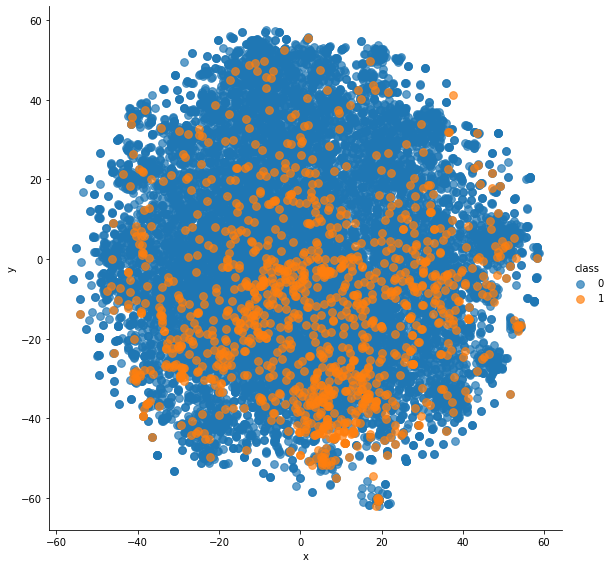

In [ ]:
# Reference: https://www.kaggle.com/masterscrat/lsa-lgbm-baseline-w-system-monitoring
xtsne=TSNE(n_components=2)
results=xtsne.fit_transform(uni_X_part2)

dftsne = pd.DataFrame(results, columns=['x','y'])
dftsne['class'] = np.array(y_part2)

# I'm no t-SNE expert but this looks pretty unpromising
ax = sns.lmplot('x', 'y', dftsne, hue='class', fit_reg=False, height=8, scatter_kws={'alpha':0.7,'s':60})


**2. Bag of Words W2V vectorizer method**

In [ ]:
bow_vectorizer = CountVectorizer(min_df = 1, max_features = 150000)
bow_vectorizer.fit_transform(X_train["comment_text"])

bow_words = set(bow_vectorizer.get_feature_names())

In [ ]:
len(bow_words)

150000

In [ ]:
#Reference: https://medium.com/analytics-vidhya/featurization-of-text-data-bow-tf-idf-avgw2v-tfidf-weighted-w2v-7a6c62e8b097
def bow_w2v(corpus, bow_words_vocab):
    vector_lst = []
    count= 0
    for sen in corpus:
        vector = np.zeros(300)
        for word in sen.split():
            if (word in glove_words) and (word in bow_words_vocab):
                vector += model[word]
                count += 1
            if count != 0:
                vector /= count
        vector_lst.append(vector)
    vector_lst = np.array(vector_lst)
    return vector_lst

In [ ]:
bow_X_part2=bow_w2v(X_part2["comment_text"],bow_words)

In [ ]:
bow_X_part2.shape

(14439, 300)

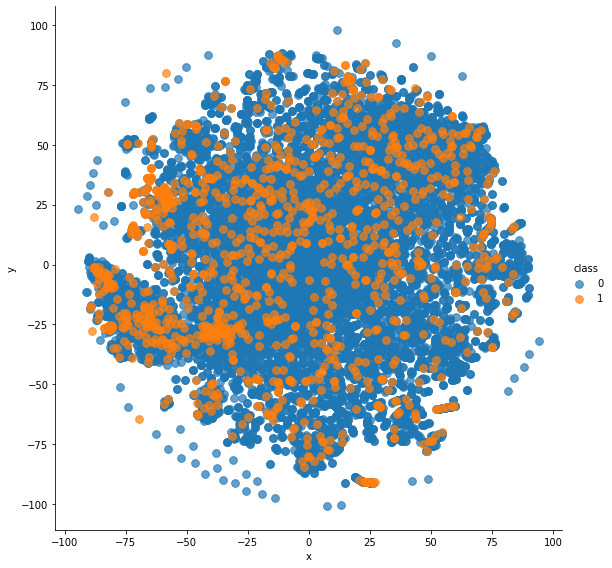

In [ ]:
xtsne=TSNE(n_components=2)
results=xtsne.fit_transform(bow_X_part2)

dftsne = pd.DataFrame(results, columns=['x','y'])
dftsne['class'] = np.array(y_part2)

# I'm no t-SNE expert but this looks pretty unpromising
ax = sns.lmplot('x', 'y', dftsne, hue='class', fit_reg=False, height=8, scatter_kws={'alpha':0.7,'s':60})

#### **Comparision:**
*   As we can observe from the above scatter plots, the two class points are not clearly separable from each other, rather overlap. 
*   However, for TFIDF vectorizer the toxic class (1) points are more scattered centrally than the BOW vectorizer toxic class, which gives some advantage over BOW vectorizer to focus on points from other class
*   BOW focuses more on the count of words, while TF-IDF focuses on more and less important words.
*   From the plots and considering our case to focus on toxic words, for further model training will be selecting TFIDF W2V vectorizer. 










***Using TFIDF W2V vectorizer***

*   Using weighting strategy TFIDF to get better meaning of each word in the comments.
*   Along with TFIDF, we using Glove Vectors for representing words to measure their semantic meaning between each words
*   Experimenting with n-gram (unigram and bigram) for getting better inference from comments.

***W2V representation and architecture***


*   Using only TFIDF vector representation leads to sparse matrix(more number of zeros) and are high-dimentional. Also does not handle OOV(out-of_vocabulary) problem
*   To overcome , TFIDF is combined with W2V embedding to have low-dimentional and dense representation.
*   Training our own word embeddings is expensive process. Thus we are using pre-trained word embedding, here Glove-vectors. 
*   Glove-vectors have vector representations for each word. Vectors that were obtained from heavy models, trained by Standford researchers. Many dimensions are available but we are using 300-dimentional word vector representation. 
*   TFIDF vectorizer provides us with tf-idf values for each word present in vocab which we are multiplying with Glove vector for that word. 
*   After getting 300 dimentional vector for each word in the document, we add them to get final 300-dimentional vector representation for each document(comment) in our data rather than vocabulary long dimentional vector representations. 









### **4.1 Unigram stacked data**

In [ ]:
def stacking_cols(data):
  temp_df=pd.DataFrame()
  for col in data.columns:
    if col not in ['id','comment_text']:
      temp_df[col]=data[col]
  return np.array(temp_df)

***Final Unigram stacked Train and validation data***

In [ ]:
X_train_stack_uni = np.hstack((np.array(uni_tfidf_w2v_X_train),stacking_cols(X_train)))
X_cv_stack_uni = np.hstack((np.array(uni_tfidf_w2v_X_cv),stacking_cols(X_cv)))
print('Final Train data shape of unigram feature data=',X_train_stack_uni.shape)
print('Final Validation data shape of unigram feature data=',X_cv_stack_uni.shape)

Final Train data shape of unigram feature data= (1443899, 312)
Final Validation data shape of unigram feature data= (360975, 312)


### **4.2 Bigram stacked data**

In [ ]:
tfidf_model_bigram = TfidfVectorizer(ngram_range = (1,2),max_features=150000)
tfidf_model_bigram.fit_transform(X_train['comment_text'])
# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(tfidf_model_bigram.get_feature_names(), list(tfidf_model_bigram.idf_)))
tfidf_words_bigram = set(tfidf_model_bigram.get_feature_names())

In [ ]:
len(tfidf_words_bigram)

150000

In [ ]:
bigram_tfidf_w2v_X_train=tfidf_w2v(X_train['comment_text'],tfidf_words_bigram)
bigram_tfidf_w2v_X_cv=tfidf_w2v(X_cv['comment_text'],tfidf_words_bigram)
bigram_tfidf_w2v_X_test=tfidf_w2v(X_test['comment_text'],tfidf_words_bigram)

100%|██████████| 97320/97320 [00:18<00:00, 5217.59it/s]


***Final Bigram vector representation for train and validation datasets***

In [ ]:
print('Train TFIDF vector representation shape:',np.array(bigram_tfidf_w2v_X_train).shape)
print('Validation TFIDF vector representation shape:',np.array(bigram_tfidf_w2v_X_cv).shape)
print('Test TFIDF vector representation shape:',np.array(bigram_tfidf_w2v_X_test).shape)

Train TFIDF vector representation shape: (1443899, 300)
Validation TFIDF vector representation shape: (360975, 300)
Test TFIDF vector representation shape: (97320, 300)


***Bigram stacked data***

In [ ]:
X_train_stack_bigram = np.hstack((bigram_tfidf_w2v_X_train,stacking_cols(X_train)))
X_cv_stack_bigram = np.hstack((bigram_tfidf_w2v_X_cv,stacking_cols(X_cv)))
print('Final Train data shape of bigram feature data=',X_train_stack_bigram.shape)
print('Final Validation data shape of bigram feature data=',X_cv_stack_bigram.shape)

Final Train data shape of bigram feature data= (1443899, 312)
Final Validation data shape of bigram feature data= (360975, 312)


## **Random Model(Worst case log-loss)**

Log loss on Test Data using Random Model 0.8887230293254303
Confusion Matrix:


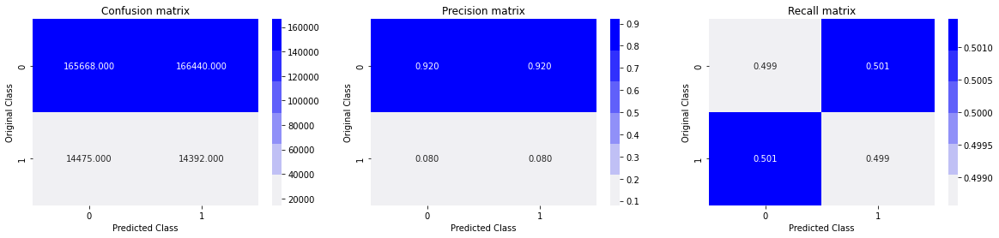

None
Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.50      0.65    332108
           1       0.08      0.50      0.14     28867

    accuracy                           0.50    360975
   macro avg       0.50      0.50      0.39    360975
weighted avg       0.85      0.50      0.61    360975

ROC-AUC Score:
0.4987000498726102


In [ ]:
ycv_len=len(y_cv)
predicted_y = np.zeros((ycv_len,2))
for i in range(ycv_len):
    rand_probs = np.random.rand(1,2)
    predicted_y[i] = ((rand_probs/sum(sum(rand_probs)))[0])
print("Log loss on Test Data using Random Model",log_loss(y_cv, predicted_y, eps=1e-15))

predicted_y =np.argmax(predicted_y, axis=1)
get_all_metrics(y_cv, predicted_y)



*   Random model results will help to mark our reference threshold. 
*   ROC-AUC score of 0.498 is reference for other models to perform better than random model.



# **Machine Learning Models**

## **1. Logistic Regression**

### **1.1 With Unigram**

In [ ]:
clf_uni = SGDClassifier(alpha=1e-05, penalty='l2', loss='log', random_state=42)
clf_uni.fit(X_train_stack_uni, y_train)

predict_y = clf_uni.predict_proba(X_train_stack_uni)
print('For values of best alpha = ', 1e-05, "The train log loss is:",log_loss(y_train, predict_y, labels=clf_uni.classes_, eps=1e-15))
predict_y = clf_uni.predict_proba(X_cv_stack_uni)
print('For values of best alpha = ', 1e-05, "The validation log loss is:",log_loss(y_cv, predict_y, labels=clf_uni.classes_, eps=1e-15))
predicted_y =np.argmax(predict_y,axis=1)
print("Total number of data points :", len(predicted_y))

For values of best alpha =  1e-05 The train log loss is: 0.26281804017962085
For values of best alpha =  1e-05 The validation log loss is: 0.26294702849827933
Total number of data points : 360975


 **1.1.1 Evaluation metrics for Unigram**

***General metrics***

Confusion Matrix:


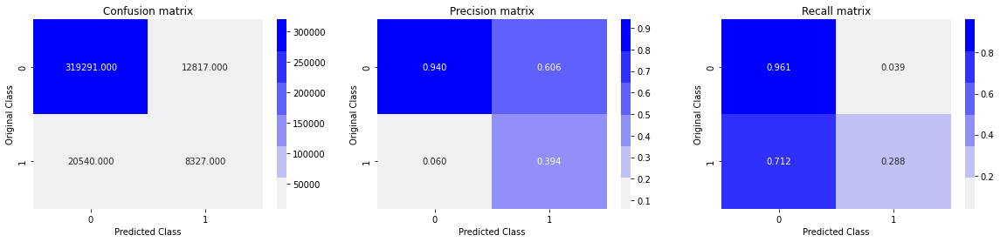

None
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.96      0.95    332108
           1       0.39      0.29      0.33     28867

    accuracy                           0.91    360975
   macro avg       0.67      0.62      0.64    360975
weighted avg       0.90      0.91      0.90    360975

ROC-AUC Score:
0.6249340024479054


In [ ]:
get_all_metrics(y_cv, predicted_y)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric(clf_uni,X_cv_stack_uni)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,my_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.466090,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.244897,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.056174,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.371960,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.170973,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, MODEL_NAME, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
6,black,3005,0.628170,0.268084,0.968201
2,homosexual_gay_or_lesbian,2167,0.644057,0.323679,0.958066
7,white,5134,0.660352,0.310655,0.967034
8,psychiatric_or_mental_illness,1026,0.675305,0.434035,0.925211
5,muslim,4309,0.680044,0.391946,0.949289
4,jewish,1460,0.728197,0.555311,0.907510
1,female,10587,0.728436,0.581639,0.899463
0,male,8889,0.748307,0.569949,0.914425
3,christian,8049,0.769806,0.725685,0.842385


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, MODEL_NAME))

0.6919712410623005

### **1.2 With Bigram**

In [ ]:
clf_bi = SGDClassifier(alpha=1e-05, penalty='l2', loss='log', random_state=42)
clf_bi.fit(X_train_stack_bigram, y_train)


predict_y = clf_bi.predict_proba(X_train_stack_bigram)
print('For values of best alpha = ', 1e-05, "The train log loss is:",log_loss(y_train, predict_y, labels=clf_bi.classes_, eps=1e-15))
predict_y = clf_bi.predict_proba(X_cv_stack_bigram)
print('For values of best alpha = ', 1e-05, "The validation log loss is:",log_loss(y_cv, predict_y, labels=clf_bi.classes_, eps=1e-15))
predicted_y =np.argmax(predict_y,axis=1)
print("Total number of data points :", len(predicted_y))

For values of best alpha =  1e-05 The train log loss is: 0.2631748237496759
For values of best alpha =  1e-05 The validation log loss is: 0.26323909067313145
Total number of data points : 360975


 **1.2.1 Evaluation metrics for Unigram**

***General metrics***

Confusion Matrix:


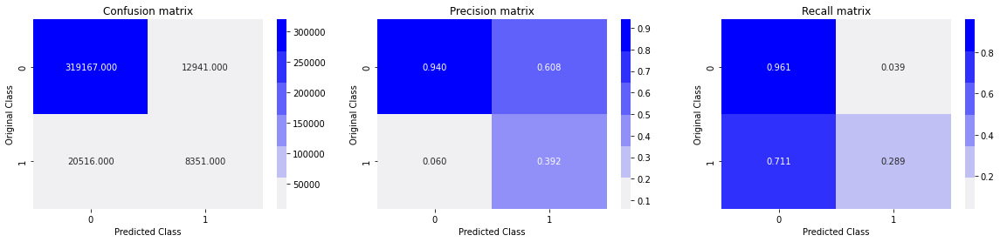

None
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.96      0.95    332108
           1       0.39      0.29      0.33     28867

    accuracy                           0.91    360975
   macro avg       0.67      0.63      0.64    360975
weighted avg       0.90      0.91      0.90    360975

ROC-AUC Score:
0.6251630157769832


In [ ]:
get_all_metrics(y_cv, predicted_y)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric(clf_bi,X_cv_stack_bigram)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,my_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.469493,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.245293,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.056239,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.371240,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.171274,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, MODEL_NAME, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
6,black,3005,0.628670,0.268423,0.968254
2,homosexual_gay_or_lesbian,2167,0.644349,0.323944,0.958402
7,white,5134,0.659602,0.310544,0.966927
8,psychiatric_or_mental_illness,1026,0.675209,0.433843,0.925381
5,muslim,4309,0.680061,0.391798,0.949921
4,jewish,1460,0.727990,0.554606,0.907643
1,female,10587,0.728174,0.581632,0.899326
0,male,8889,0.748386,0.569993,0.914469
3,christian,8049,0.769361,0.725419,0.842267


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, MODEL_NAME))

0.6920593700177813

## **2. Decision Tree Classifier**

### **2.1 For Unigram**

In [ ]:
dt_clf = DecisionTreeClassifier(max_depth = 13,random_state = 42)
                                        
dt_clf.fit(X_train_stack_uni,y_train)
valid_score=dt_clf.score(X_cv_stack_uni,y_cv)
print('Percentage of points incorrectly predicted=',(1-valid_score)*100)


Percentage of points incorrectly predicted= 8.177851651776436


 **2.1.1 Evaluation metrics for Unigram**

***General metrics***

Confusion Matrix:


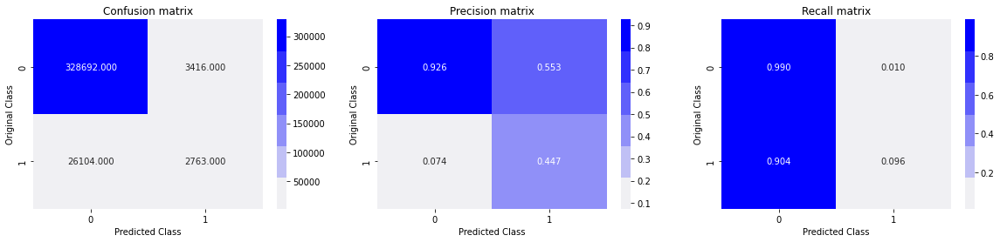

None
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.99      0.96    332108
           1       0.45      0.10      0.16     28867

    accuracy                           0.92    360975
   macro avg       0.69      0.54      0.56    360975
weighted avg       0.89      0.92      0.89    360975

ROC-AUC Score:
0.5427145097214406


In [ ]:
y_pred=dt_clf.predict(X_cv_stack_uni)
get_all_metrics(y_cv,y_pred)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric(dt_clf,X_cv_stack_uni)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,my_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.064548,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.036683,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.041677,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.049708,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.089095,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, MODEL_NAME, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
7,white,5134,0.627233,0.501709,0.815566
6,black,3005,0.628957,0.506665,0.820538
2,homosexual_gay_or_lesbian,2167,0.634984,0.566929,0.782949
5,muslim,4309,0.645180,0.566246,0.789573
4,jewish,1460,0.682160,0.621571,0.784041
0,male,8889,0.689282,0.597361,0.810297
1,female,10587,0.693644,0.626389,0.794328
8,psychiatric_or_mental_illness,1026,0.696719,0.708134,0.721362
3,christian,8049,0.699036,0.719388,0.717066


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, MODEL_NAME))

0.6879170181586265

### **2.2 With Bigram**

In [ ]:
dt_clf = DecisionTreeClassifier(max_depth = 10,random_state = 42)
                                        
dt_clf.fit(X_train_stack_bigram,y_train)
valid_score=dt_clf.score(X_cv_stack_bigram,y_cv)
print('Percentage of points incorrectly predicted=',(1-valid_score)*100)

Percentage of points incorrectly predicted= 7.929912043770349


 **2.2.1 Evaluation metrics for Bigram**

***General metrics***

Confusion Matrix:


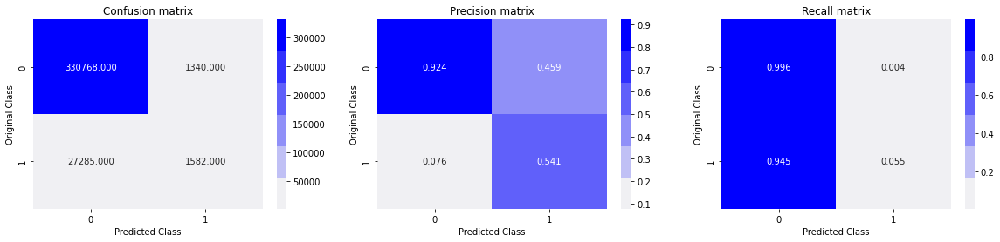

None
Classification Report:
              precision    recall  f1-score   support

           0       0.92      1.00      0.96    332108
           1       0.54      0.05      0.10     28867

    accuracy                           0.92    360975
   macro avg       0.73      0.53      0.53    360975
weighted avg       0.89      0.92      0.89    360975

ROC-AUC Score:
0.525384115138854


In [ ]:
y_pred=dt_clf.predict(X_cv_stack_bigram)
get_all_metrics(y_cv,y_pred)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric(dt_clf,X_cv_stack_bigram)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,my_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.113074,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.095156,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.051975,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.042393,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.138034,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, MODEL_NAME, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
7,white,5134,0.635086,0.445236,0.877977
5,muslim,4309,0.637403,0.489650,0.854579
6,black,3005,0.644896,0.476124,0.866247
2,homosexual_gay_or_lesbian,2167,0.654923,0.546349,0.829081
0,male,8889,0.693865,0.596012,0.824897
4,jewish,1460,0.695127,0.599619,0.824563
1,female,10587,0.698087,0.635347,0.803217
3,christian,8049,0.717518,0.714365,0.749126
8,psychiatric_or_mental_illness,1026,0.717959,0.716685,0.743127


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, MODEL_NAME))

0.6915388609081989

## **3. Linear SVM**

### **3.1 For Unigram**

In [ ]:
clf_uni = SGDClassifier(alpha=1e-05, penalty='l1', loss='hinge', random_state=42)
clf_uni.fit(X_train_stack_uni, y_train)
sig_clf = CalibratedClassifierCV(clf_uni, method="sigmoid")
sig_clf.fit(X_train_stack_uni, y_train)

predict_y = sig_clf.predict_proba(X_train_stack_uni)
print('For values of best alpha = ', 1e-05, "The train log loss is:",log_loss(y_train, predict_y, labels=clf_uni.classes_, eps=1e-15))
predict_y = sig_clf.predict_proba(X_cv_stack_uni)
print('For values of best alpha = ', 1e-05, "The validation log loss is:",log_loss(y_cv, predict_y, labels=clf_uni.classes_, eps=1e-15))
predicted_y =np.argmax(predict_y,axis=1)
print("Total number of data points :", len(predicted_y))

For values of best alpha =  1e-05 The train log loss is: 0.2409187680347016
For values of best alpha =  1e-05 The validation log loss is: 0.24044397397875925
Total number of data points : 360975


**3.1.1 Evaluation metrics for Unigram**

***General metrics***

Confusion Matrix:


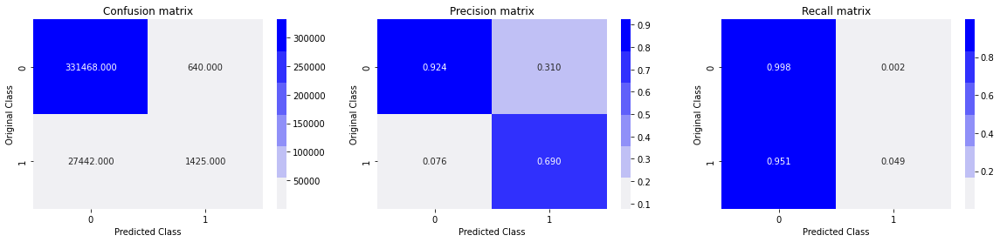

None
Classification Report:
              precision    recall  f1-score   support

           0       0.92      1.00      0.96    332108
           1       0.69      0.05      0.09     28867

    accuracy                           0.92    360975
   macro avg       0.81      0.52      0.53    360975
weighted avg       0.90      0.92      0.89    360975

ROC-AUC Score:
0.523718621043202


In [ ]:
get_all_metrics(y_cv, predicted_y)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric(sig_clf,X_cv_stack_uni)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,my_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.252665,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.095331,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.094839,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.233901,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.082476,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, MODEL_NAME, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
6,black,3005,0.689609,0.371052,0.936052
7,white,5134,0.697579,0.417544,0.927211
2,homosexual_gay_or_lesbian,2167,0.714492,0.423590,0.928835
1,female,10587,0.724521,0.689131,0.795349
5,muslim,4309,0.728084,0.512595,0.909897
0,male,8889,0.739176,0.663369,0.823122
4,jewish,1460,0.751377,0.674723,0.825297
3,christian,8049,0.778325,0.814518,0.724949
8,psychiatric_or_mental_illness,1026,0.811497,0.551229,0.930057


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, MODEL_NAME))

0.7049962752056284

### **3.2 With Bigram**

In [ ]:
clf_bi = SGDClassifier(alpha=1e-05, penalty='l1', loss='hinge', random_state=42)
clf_bi.fit(X_train_stack_bigram, y_train)
sig_clf = CalibratedClassifierCV(clf_bi, method="sigmoid")
sig_clf.fit(X_train_stack_bigram, y_train)

predict_y = sig_clf.predict_proba(X_train_stack_bigram)
print('For values of best alpha = ', 1e-05, "The train log loss is:",log_loss(y_train, predict_y, labels=sig_clf.classes_, eps=1e-15))
predict_y = sig_clf.predict_proba(X_cv_stack_bigram)
print('For values of best alpha = ', 1e-05, "The validation log loss is:",log_loss(y_cv, predict_y, labels=sig_clf.classes_, eps=1e-15))
predicted_y =np.argmax(predict_y,axis=1)
print("Total number of data points :", len(predicted_y))

For values of best alpha =  1e-05 The train log loss is: 0.24575664369237427
For values of best alpha =  1e-05 The validation log loss is: 0.24570357704607362
Total number of data points : 360975


 **3.2.1 Evaluation metrics for Bigram**

***General metrics***

Confusion Matrix:


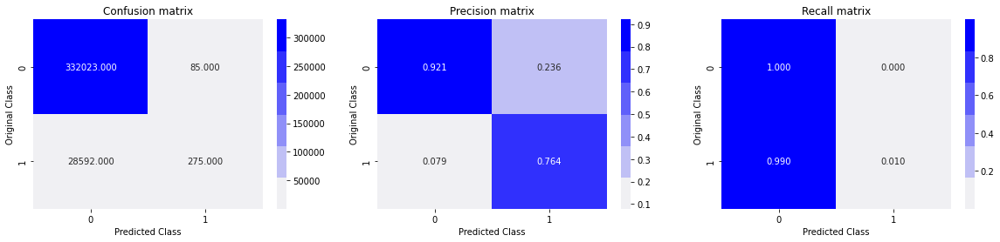

None
Classification Report:
              precision    recall  f1-score   support

           0       0.92      1.00      0.96    332108
           1       0.76      0.01      0.02     28867

    accuracy                           0.92    360975
   macro avg       0.84      0.50      0.49    360975
weighted avg       0.91      0.92      0.88    360975

ROC-AUC Score:
0.5046352540238744


In [ ]:
get_all_metrics(y_cv, predicted_y)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric(sig_clf,X_cv_stack_bigram)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,my_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.165035,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.090729,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.090960,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.149983,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.082137,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, MODEL_NAME, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
6,black,3005,0.660129,0.252297,0.972907
2,homosexual_gay_or_lesbian,2167,0.683437,0.324687,0.960733
7,white,5134,0.684711,0.324012,0.966548
5,muslim,4309,0.720106,0.439679,0.943076
1,female,10587,0.738974,0.646310,0.853990
0,male,8889,0.752528,0.621148,0.877079
4,jewish,1460,0.752705,0.628655,0.870239
8,psychiatric_or_mental_illness,1026,0.773994,0.471330,0.947315
3,christian,8049,0.785293,0.792090,0.775104


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, MODEL_NAME))

0.6868822263670362

## **4. LightGBM**

### **4.1 For Unigram**

In [ ]:
lgbmmodel = LGBMClassifier()
lgbmmodel.fit(X_train_stack_uni,y_train)

predict_y = lgbmmodel.predict_proba(X_train_stack_uni)
print('For values of best alpha = ', 1e-05, "The train log loss is:",log_loss(y_train, predict_y, labels=lgbmmodel.classes_, eps=1e-15))
predict_y = lgbmmodel.predict_proba(X_cv_stack_uni)
print('For values of best alpha = ', 1e-05, "The validation log loss is:",log_loss(y_cv, predict_y, labels=lgbmmodel.classes_, eps=1e-15))
predicted_y =np.argmax(predict_y,axis=1)
print("Total number of data points :", len(predicted_y))

For values of best alpha =  1e-05 The train log loss is: 0.21283180934651885
For values of best alpha =  1e-05 The validation log loss is: 0.21706041195384213
Total number of data points : 360975


**4.1.1 Evaluation metrics for Unigram**

***General metrics***

Confusion Matrix:


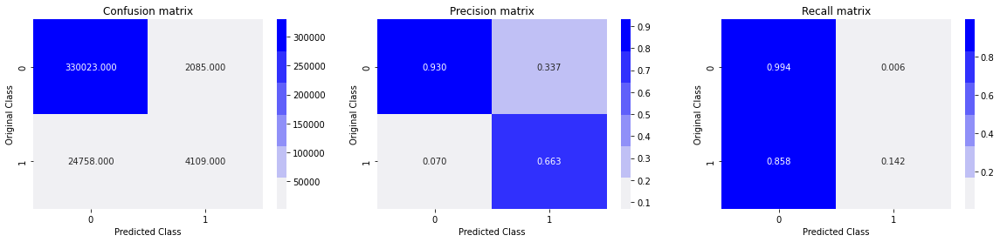

None
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.99      0.96    332108
           1       0.66      0.14      0.23     28867

    accuracy                           0.93    360975
   macro avg       0.80      0.57      0.60    360975
weighted avg       0.91      0.93      0.90    360975

ROC-AUC Score:
0.5680321944807666


In [ ]:
get_all_metrics(y_cv, predicted_y)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric(lgbmmodel,X_cv_stack_uni)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,my_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.155980,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.120811,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.096786,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.116260,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.105379,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, MODEL_NAME, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
7,white,5134,0.711344,0.475931,0.947335
6,black,3005,0.714829,0.449081,0.956674
2,homosexual_gay_or_lesbian,2167,0.735135,0.496068,0.951042
5,muslim,4309,0.746247,0.545338,0.939499
4,jewish,1460,0.763971,0.674035,0.892826
1,female,10587,0.778043,0.704506,0.884566
0,male,8889,0.782693,0.664380,0.906117
8,psychiatric_or_mental_illness,1026,0.819891,0.672911,0.917526
3,christian,8049,0.824638,0.809593,0.841505


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, MODEL_NAME))

0.7613505867582371

### **4.2 With Bigram**

In [ ]:
lgbmmodel = LGBMClassifier()
lgbmmodel.fit(X_train_stack_bigram,y_train)

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

In [ ]:
predict_y = lgbmmodel.predict_proba(X_train_stack_bigram)
print('For values of best alpha = ', 1e-05, "The train log loss is:",log_loss(y_train, predict_y, labels=lgbmmodel.classes_, eps=1e-15))
predict_y = lgbmmodel.predict_proba(X_cv_stack_bigram)
print('For values of best alpha = ', 1e-05, "The validation log loss is:",log_loss(y_cv, predict_y, labels=lgbmmodel.classes_, eps=1e-15))
predicted_y =np.argmax(predict_y,axis=1)
print("Total number of data points :", len(predicted_y))

For values of best alpha =  1e-05 The train log loss is: 0.21267078446532425
For values of best alpha =  1e-05 The validation log loss is: 0.21708677793759043
Total number of data points : 360975


 **4.2.1 Evaluation metrics for Bigram**

***General metrics***

Confusion Matrix:


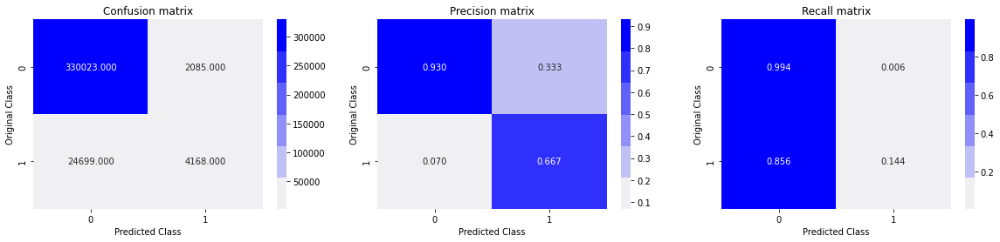

None
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.99      0.96    332108
           1       0.67      0.14      0.24     28867

    accuracy                           0.93    360975
   macro avg       0.80      0.57      0.60    360975
weighted avg       0.91      0.93      0.90    360975

ROC-AUC Score:
0.5690541226340211


In [ ]:
get_all_metrics(y_cv, predicted_y)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric(lgbmmodel,X_cv_stack_bigram)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,my_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.132931,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.159549,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.080942,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.153672,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.123644,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, MODEL_NAME, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
7,white,5134,0.711572,0.479363,0.947532
6,black,3005,0.716032,0.451057,0.956822
2,homosexual_gay_or_lesbian,2167,0.729363,0.499213,0.950592
5,muslim,4309,0.743607,0.547947,0.938000
4,jewish,1460,0.764980,0.676860,0.891834
1,female,10587,0.777744,0.704946,0.884220
0,male,8889,0.781053,0.664745,0.905121
3,christian,8049,0.822204,0.810927,0.838295
8,psychiatric_or_mental_illness,1026,0.824541,0.664193,0.924165


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, MODEL_NAME))

0.7616833880356824

## **Inferences from ML models results:**



In [ ]:
from tabulate import tabulate
table = [["Logistic \nRegression","Unigram : 0.624\nBigram : 0.625","Unigram : 0.691\nBigram : 0.692"],
         ["Decision Tree\nClassifier","Unigram : 0.542 \nBigram : 0.504","Unigram : 0.704 \nBigram : 0.692"],
         ["Linear SVM","Unigram : 0.523 \nBigram : 0.550","Unigram : 0.743 \nBigram : 0.686"],
         ["LightGBM","Unigram : 0.568 \nBigram : 0.569","Unigram : 0.761 \nBigram : 0.761"]]
headers = ["Model", "ROC-AUC score","Evaluation metric"]
print(tabulate(table, headers, tablefmt="grid"))

+---------------+------------------+---------------------+
| Model         | ROC-AUC score    | Evaluation metric   |
+===============+==================+=====================+
| Logistic      | Unigram : 0.624  | Unigram : 0.691     |
| Regression    | Bigram : 0.625   | Bigram : 0.692      |
+---------------+------------------+---------------------+
| Decision Tree | Unigram : 0.542  | Unigram : 0.704     |
| Classifier    | Bigram : 0.504   | Bigram : 0.692      |
+---------------+------------------+---------------------+
| Linear SVM    | Unigram : 0.523  | Unigram : 0.743     |
|               | Bigram : 0.550   | Bigram : 0.686      |
+---------------+------------------+---------------------+
| LightGBM      | Unigram : 0.568  | Unigram : 0.761     |
|               | Bigram : 0.569   | Bigram : 0.761      |
+---------------+------------------+---------------------+



*   Adding new features from the comments text boosts our performance on machine learning models.
*   Logistic Regression and Linear SVM works good on binary classification problems, but in our case ,as there is only a fine margin gap between the classes(as per our EDA analysis), we are not getting better results with ML models.
*   There is very small difference between unigram and bigram results.
*   Decision trees and ensemble models have high computational cost, so have experimented with least parameters, but do provide good performance.
*   LightGBM performs best among all the ensemble models, it is also faster than XGboost. As our dataset is large LGBM handles large data and less memory to run.

# **Deep Learning Models**

In [ ]:
from tensorflow.keras.layers import Dense,Input,Activation,Concatenate,Conv1D,Embedding,MaxPool1D,Flatten,Dropout,Activation,LSTM,BatchNormalization,Bidirectional
from tensorflow.keras.models import Model,Sequential
from tensorflow.keras.callbacks import EarlyStopping
import tensorflow as tf
import datetime

***Text Representations for Neural Networks:***

For Neural Networks we are further preprocessing the input vectors, with steps involved:

*   Tokenize the documents and convert them into word index vector
*   Padding the sequences obtained to get text vectors of same length
*   Generating a (vocab length, 300) size zeros matrix, where 300 is dimentional size for pretrained Glove-vectors
*   Updating this matrix with mapping of Glove-vectors for words that are in the vocabulary. Hence passing this matrix as weights to custom Embedding Layer.
*   And passing the padded sequences for train and test texts as input to model while training.







In [ ]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
to_exclude = '!"#$%&()*+-/:;<=>@[\\]^.,:;!?`{|}~\t\n'
t_model1 = Tokenizer(filters=to_exclude)

t_model1.fit_on_texts(X_train['comment_text'])
# print(t.word_index)
X_train_tokenizer_model1=t_model1.texts_to_sequences(X_train['comment_text'])
X_cv_tokenizer_model1=t_model1.texts_to_sequences(X_cv['comment_text'])

padded_X_train_seq=pad_sequences(sequences=X_train_tokenizer_model1,value=0,maxlen=500)
padded_X_cv_seq=pad_sequences(sequences=X_cv_tokenizer_model1,value=0,maxlen=500)


In [ ]:
vocab_size1 = len(t_model1.word_index) + 1
vocab_size1

276276

In [ ]:
import pickle
with open('/content/drive/MyDrive/Work_files/glove_vectors', 'rb') as f:
    model = pickle.load(f)
embedding_matrix1 = np.zeros((vocab_size1, 300))
for word, i in t_model1.word_index.items():
	embedding_vector1 = model.get(word)
	if embedding_vector1 is not None:
		embedding_matrix1[i] = embedding_vector1

In [ ]:
embedding_matrix1.shape

(276276, 300)

In [ ]:
from keras.utils import np_utils
Y_train = np_utils.to_categorical(y_train, 2) 
Y_cv = np_utils.to_categorical(y_cv, 2)

In [ ]:
!rm -rf '/content/logs_model3\fit\20211028-143032'

## **1. Building model without Embedding layer and passing TFIDF-W2V sequence**

In [ ]:
input_layer=Input(shape=(312,))
dense_layer1=Dense(40,activation='relu')(input_layer)
BN_layer=BatchNormalization()(dense_layer1)
dense_layer2=Dense(40,activation='relu')(BN_layer)
dropout_layer=Dropout(0.2)(dense_layer2)
dense_layer3=Dense(30,activation='relu')(dropout_layer)
dropout_layer1=Dropout(0.2)(dense_layer3)
dense_layer4=Dense(30,activation='relu')(dropout_layer1)

dropout_layer2=Dropout(0.2)(dense_layer4)
dense_layer5=Dense(20,activation='relu')(dropout_layer2)

output_layer=Dense(2,activation='softmax')(dense_layer5)

model1=Model(inputs=input_layer,outputs=output_layer)
model1.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 312)]             0         
_________________________________________________________________
dense_9 (Dense)              (None, 40)                12520     
_________________________________________________________________
batch_normalization_1 (Batch (None, 40)                160       
_________________________________________________________________
dense_10 (Dense)             (None, 40)                1640      
_________________________________________________________________
dropout_4 (Dropout)          (None, 40)                0         
_________________________________________________________________
dense_11 (Dense)             (None, 30)                1230      
_________________________________________________________________
dropout_5 (Dropout)          (None, 30)                0   

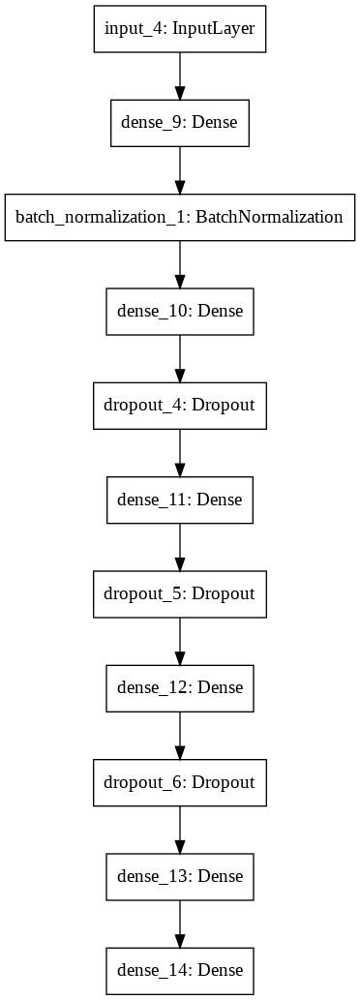

In [ ]:
plot_model(model1)

In [ ]:
earlystop=tf.keras.callbacks.EarlyStopping(monitor='val_auc', patience=2, verbose=1)
log_dir="logs_model1\\fit\\" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1, write_graph=True,write_grads=True)

model1.compile(optimizer='adam',loss='categorical_crossentropy',metrics=[tf.keras.metrics.AUC(name='auc')])

model1.fit(X_train_stack_uni,Y_train,epochs=10,validation_data=(X_cv_stack_uni,Y_cv),batch_size=32,callbacks=[earlystop,tensorboard_callback])

Epoch 1/10
45122/45122 [==============================] - 235s 5ms/step - loss: 0.2218 - auc: 0.9667 - val_loss: 0.2165 - val_auc: 0.9699
Epoch 2/10
45122/45122 [==============================] - 231s 5ms/step - loss: 0.2146 - auc: 0.9689 - val_loss: 0.2188 - val_auc: 0.9702
Epoch 3/10
45122/45122 [==============================] - 231s 5ms/step - loss: 0.2127 - auc: 0.9695 - val_loss: 0.2108 - val_auc: 0.9710
Epoch 00003: early stopping


In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir="/content/logs_model1\fit\20211028-134053"

<IPython.core.display.Javascript object>

### **1.1 Evaluation metrics**

***General metrics***

Confusion Matrix:


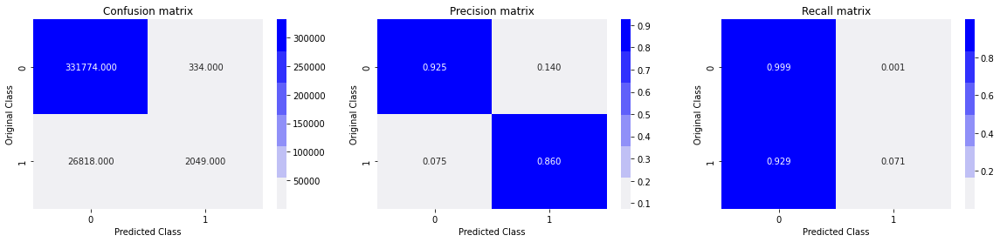

None
Classification Report:
              precision    recall  f1-score   support

           0       0.93      1.00      0.96    332108
           1       0.86      0.07      0.13     28867

    accuracy                           0.92    360975
   macro avg       0.89      0.53      0.55    360975
weighted avg       0.92      0.92      0.89    360975

ROC-AUC Score:
0.5349875038344213


In [ ]:
predict_y = model1.predict(X_cv_stack_uni)
y_pred=np.argmax(predict_y,axis=1)
get_all_metrics(y_cv, y_pred)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric_forDL(model1,X_cv_stack_uni)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,dl_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.388135,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.081863,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.036020,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.183317,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.090009,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, DL_Model_name, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
7,white,5134,0.732696,0.512944,0.956079
6,black,3005,0.740546,0.459453,0.968587
2,homosexual_gay_or_lesbian,2167,0.742936,0.509307,0.959378
5,muslim,4309,0.751335,0.608222,0.933382
4,jewish,1460,0.786617,0.737922,0.886083
1,female,10587,0.800818,0.749863,0.887724
0,male,8889,0.805325,0.729898,0.901034
8,psychiatric_or_mental_illness,1026,0.826489,0.640793,0.941102
3,christian,8049,0.842739,0.838043,0.852087


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, DL_Model_name))

0.7779609563006802

## **2. Building model with CNN and Embedded layers**

In [ ]:
#MODEL 2
input_layer=Input(shape=(500,))

emb_layer = Embedding(vocab_size1, 300, weights=[embedding_matrix1], input_length=4, trainable=False)(input_layer)

conv1d_layer1=Conv1D(filters=14,kernel_size=1,padding='same',activation='relu',strides=1)(emb_layer)
maxpool1d_layer1=MaxPool1D(pool_size=1,strides=1,padding='same')(conv1d_layer1)

conv1d_layer2=Conv1D(filters=11,kernel_size=1,padding='same',activation='relu',strides=1)(maxpool1d_layer1)
maxpool1d_layer2=MaxPool1D(pool_size=1,strides=1,padding='same')(conv1d_layer2)

flatten_layer=Flatten()(maxpool1d_layer2)
dropout_layer=Dropout(0.2)(flatten_layer)
activation_layer=Activation('relu')(dropout_layer)
dense_layer=Dense(50,activation='relu')(activation_layer)
output_layer=Dense(2,activation='softmax')(dense_layer)

model2=Model(inputs=input_layer,outputs=output_layer)
model2.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 500)]             0         
_________________________________________________________________
embedding_3 (Embedding)      (None, 500, 300)          82882800  
_________________________________________________________________
conv1d (Conv1D)              (None, 500, 14)           4214      
_________________________________________________________________
max_pooling1d (MaxPooling1D) (None, 500, 14)           0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 500, 11)           165       
_________________________________________________________________
max_pooling1d_1 (MaxPooling1 (None, 500, 11)           0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 5500)              0   

In [ ]:
plot_model(model2)

In [ ]:

earlystop=tf.keras.callbacks.EarlyStopping(monitor='val_auc', patience=2, verbose=1)
log_dir="logs_model2\\fit\\" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1, write_graph=True,write_grads=True)

model2.compile(optimizer='adam',loss='categorical_crossentropy',metrics=[tf.keras.metrics.AUC(name='auc')])

model2.fit(padded_X_train_seq,Y_train,epochs=10,validation_data=(padded_X_cv_seq,Y_cv),batch_size=32,callbacks=[earlystop,tensorboard_callback])

Epoch 1/10
45122/45122 [==============================] - 246s 5ms/step - loss: 0.1996 - auc: 0.9726 - val_loss: 0.1835 - val_auc: 0.9783
Epoch 2/10
45122/45122 [==============================] - 235s 5ms/step - loss: 0.1920 - auc: 0.9749 - val_loss: 0.1802 - val_auc: 0.9794
Epoch 3/10
45122/45122 [==============================] - 235s 5ms/step - loss: 0.1904 - auc: 0.9754 - val_loss: 0.1787 - val_auc: 0.9792
Epoch 00003: early stopping


In [ ]:
loss,auc_score=model2.evaluate(padded_X_train_seq,Y_train)
print("The train loss={} and train AUC score= {}".format(round(loss,4),round(auc_score,4)))
print(" ")
loss,auc_score=model2.evaluate(padded_X_cv_seq,Y_cv)
print("The validation loss={} and validation AUC score= {}".format(round(loss,4),round(auc_score,4)))

45122/45122 [==============================] - 149s 3ms/step - loss: 0.1765 - auc: 0.9798
The train loss=0.1765 and train AUC score= 0.9798
 
11281/11281 [==============================] - 37s 3ms/step - loss: 0.1787 - auc: 0.9792
The validation loss=0.1787 and validation AUC score= 0.9792


In [ ]:
%tensorboard --logdir="/content/logs_model2\fit\20211019-090430"

<IPython.core.display.Javascript object>

### **2.1 Evaluation metrics**

***General metrics***

In [ ]:
predict_y = model2.predict(padded_X_cv_seq)
y_pred=np.argmax(predict_y,axis=1)

Confusion Matrix:


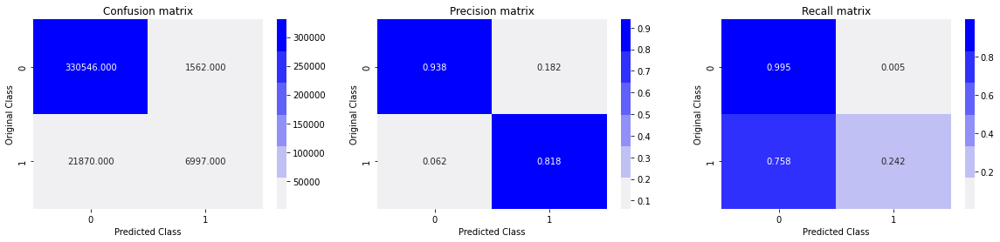

None
Classification Report:
              precision    recall  f1-score   support

           0       0.94      1.00      0.97    332108
           1       0.82      0.24      0.37     28867

    accuracy                           0.94    360975
   macro avg       0.88      0.62      0.67    360975
weighted avg       0.93      0.94      0.92    360975

ROC-AUC Score:
0.618842106003813


In [ ]:
get_all_metrics(y_cv, y_pred)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric_forDL(model2,padded_X_cv_seq)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,dl_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.566246,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.103631,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.020459,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.093722,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.049015,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, DL_Model_name, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
2,homosexual_gay_or_lesbian,2167,0.758736,0.709667,0.934269
6,black,3005,0.783395,0.652545,0.960484
7,white,5134,0.787087,0.690426,0.949472
5,muslim,4309,0.795096,0.714849,0.946833
4,jewish,1460,0.827766,0.796402,0.920360
8,psychiatric_or_mental_illness,1026,0.838610,0.690471,0.961571
1,female,10587,0.851446,0.831872,0.914491
0,male,8889,0.855884,0.815339,0.926203
3,christian,8049,0.874707,0.880122,0.893469


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, DL_Model_name))

0.8440074563439905

## **3. Building model with LSTM and Embedding layers**

In [ ]:
# MODEL 3
input_layer=Input(shape=(500,))
emb_layer= Embedding(vocab_size1, 300, weights=[embedding_matrix1], trainable=False)(input_layer)
lstm_layer1=LSTM(40, return_sequences=True, return_state=False)(emb_layer)
lstm_layer2=LSTM(50, return_sequences=True, return_state=False)(lstm_layer1)
flatten_layer=Flatten()(lstm_layer2)

dense_layer1=Dense(64,activation='relu')(flatten_layer)
dropout_layer1=Dropout(0.2)(dense_layer1)
dense_layer2=Dense(64,activation='relu')(dropout_layer1)
output_layer=Dense(2,activation='softmax')(dense_layer2)

model3=Model(inputs=input_layer,outputs=output_layer)
model3.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 500)]             0         
_________________________________________________________________
embedding (Embedding)        (None, 500, 300)          82882800  
_________________________________________________________________
lstm (LSTM)                  (None, 500, 40)           54560     
_________________________________________________________________
lstm_1 (LSTM)                (None, 500, 50)           18200     
_________________________________________________________________
flatten (Flatten)            (None, 25000)             0         
_________________________________________________________________
dense (Dense)                (None, 64)                1600064   
_________________________________________________________________
dropout (Dropout)            (None, 64)                0     

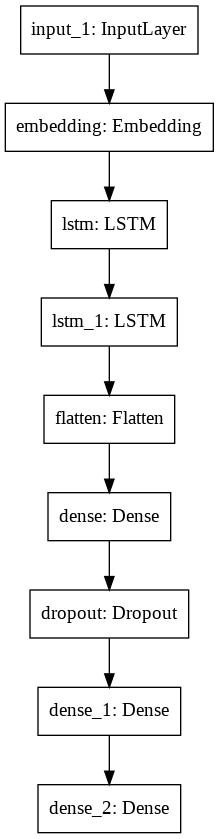

In [ ]:
plot_model(model3)

In [ ]:

earlystop=tf.keras.callbacks.EarlyStopping(monitor='val_auc', patience=2, verbose=1)
log_dir="logs_model3\\fit\\" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1, write_graph=True,write_grads=True)

model3.compile(optimizer='adam',loss='categorical_crossentropy',metrics=[tf.keras.metrics.AUC(name='auc')])

model3.fit(padded_X_train_seq,Y_train,epochs=10,validation_data=(padded_X_cv_seq,Y_cv),batch_size=32,callbacks=[earlystop,tensorboard_callback])

Epoch 1/10
45122/45122 [==============================] - 1993s 44ms/step - loss: 0.1742 - auc: 0.9801 - val_loss: 0.1652 - val_auc: 0.9826
Epoch 2/10
45122/45122 [==============================] - 1981s 44ms/step - loss: 0.1632 - auc: 0.9828 - val_loss: 0.1675 - val_auc: 0.9828
Epoch 3/10
45122/45122 [==============================] - 1982s 44ms/step - loss: 0.1592 - auc: 0.9837 - val_loss: 0.1651 - val_auc: 0.9828
Epoch 00003: early stopping


In [ ]:
loss,auc_score=model3.evaluate(padded_X_train_seq,Y_train)
print("The train loss={} and train AUC score= {}".format(loss,auc_score))
loss,auc_score=model3.evaluate(padded_X_cv_seq,Y_cv)
print("The validation loss={} and validation AUC score= {}".format(loss,auc_score))

45122/45122 [==============================] - 854s 19ms/step - loss: 0.1572 - auc: 0.9850
The train loss=0.1572081744670868 and train AUC score= 0.984991729259491
11281/11281 [==============================] - 214s 19ms/step - loss: 0.1651 - auc: 0.9828
The validation loss=0.16510257124900818 and validation AUC score= 0.9827823638916016


In [ ]:
%tensorboard --logdir="/content/logs_model3\fit\20211028-151556"

<IPython.core.display.Javascript object>

### **3.1 Evaluation metrics**

***General metrics***

In [ ]:
predict_y = model3.predict(padded_X_cv_seq)
y_pred=y_pred=np.argmax(predict_y,axis=1)

Confusion Matrix:


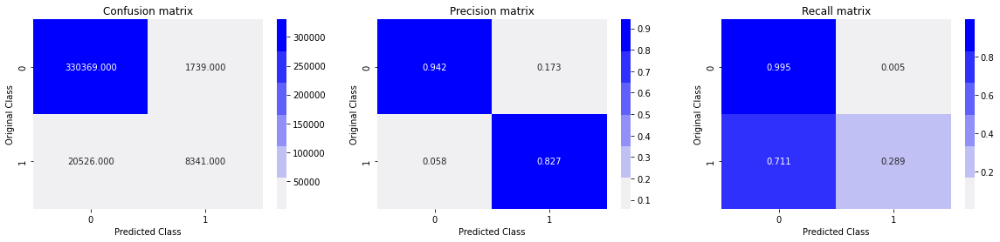

None
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.99      0.97    332108
           1       0.83      0.29      0.43     28867

    accuracy                           0.94    360975
   macro avg       0.88      0.64      0.70    360975
weighted avg       0.93      0.94      0.92    360975

ROC-AUC Score:
0.641854803339697


In [ ]:
get_all_metrics(y_cv, y_pred)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric_forDL(model3,padded_X_cv_seq)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,dl_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.895951,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.113918,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.005522,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.027993,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.081210,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, DL_Model_name, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
2,homosexual_gay_or_lesbian,2167,0.792817,0.752263,0.945346
7,white,5134,0.806243,0.719541,0.956872
6,black,3005,0.814569,0.719471,0.960599
5,muslim,4309,0.826221,0.771906,0.947596
4,jewish,1460,0.845103,0.824544,0.933401
1,female,10587,0.879383,0.867791,0.927740
0,male,8889,0.880464,0.852932,0.937135
8,psychiatric_or_mental_illness,1026,0.881269,0.841524,0.942866
3,christian,8049,0.889419,0.896478,0.912163


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, DL_Model_name))

0.8721280516342991

In [ ]:
model3.save("/content/drive/MyDrive/Work_files/Jigsaw_toxicity_classification/model3_2.h5")

## **4. Building model with Bidirectional RNN and Embedding layers**

In [ ]:
# MODEL 4
input_layer=Input(shape=(500,))
emb_layer= Embedding(vocab_size1, 300, weights=[embedding_matrix1], trainable=False)(input_layer)
bidirec_lstm1=Bidirectional(LSTM(40, return_sequences=True))(emb_layer)
bidirec_lstm2=Bidirectional(LSTM(50, return_sequences=True))(bidirec_lstm1)
flatten_layer=Flatten()(bidirec_lstm2)

dense_layer1=Dense(64,activation='relu')(flatten_layer)
dropout_layer1=Dropout(0.2)(dense_layer1)
dense_layer2=Dense(64,activation='relu')(dropout_layer1)
output_layer=Dense(2,activation='softmax')(dense_layer2)

model4=Model(inputs=input_layer,outputs=output_layer)
model4.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 500)]             0         
_________________________________________________________________
embedding (Embedding)        (None, 500, 300)          82882800  
_________________________________________________________________
bidirectional (Bidirectional (None, 500, 80)           109120    
_________________________________________________________________
bidirectional_1 (Bidirection (None, 500, 100)          52400     
_________________________________________________________________
flatten (Flatten)            (None, 50000)             0         
_________________________________________________________________
dense (Dense)                (None, 64)                3200064   
_________________________________________________________________
dropout (Dropout)            (None, 64)                0     

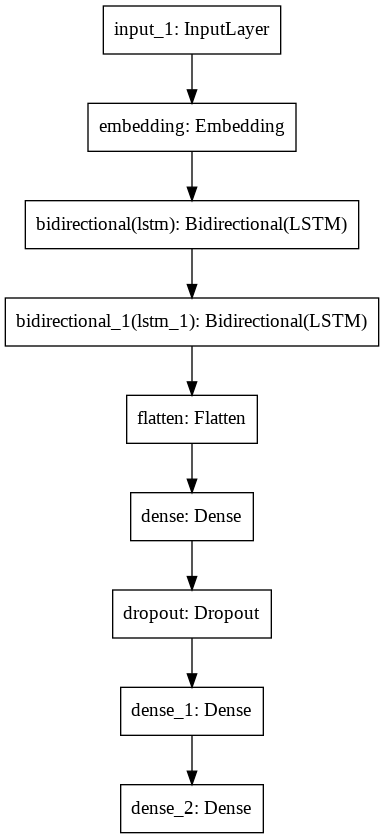

In [ ]:
plot_model(model4)

In [ ]:

earlystop=tf.keras.callbacks.EarlyStopping(monitor='val_auc', patience=2, verbose=1)
log_dir="logs_model4\\fit\\" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1, write_graph=True,write_grads=True)

model4.compile(optimizer='adam',loss='categorical_crossentropy',metrics=[tf.keras.metrics.AUC(name='auc')])

model4.fit(padded_X_train_seq,Y_train,epochs=10,validation_data=(padded_X_cv_seq,Y_cv),batch_size=32,callbacks=[earlystop,tensorboard_callback])

Epoch 1/10
45122/45122 [==============================] - 5296s 117ms/step - loss: 0.1731 - auc: 0.9804 - val_loss: 0.1652 - val_auc: 0.9826
Epoch 2/10
45122/45122 [==============================] - 5312s 118ms/step - loss: 0.1621 - auc: 0.9831 - val_loss: 0.1640 - val_auc: 0.9830
Epoch 3/10
45122/45122 [==============================] - 5360s 119ms/step - loss: 0.1570 - auc: 0.9842 - val_loss: 0.1625 - val_auc: 0.9831
Epoch 00003: early stopping


In [ ]:
loss,auc_score=model4.evaluate(padded_X_train_seq,Y_train)
print("The train loss={} and train AUC score= {}".format(loss,auc_score))
loss,auc_score=model4.evaluate(padded_X_cv_seq,Y_cv)
print("The validation loss={} and validation AUC score= {}".format(loss,auc_score))

45122/45122 [==============================] - 2306s 51ms/step - loss: 0.1517 - auc: 0.9859
The train loss=0.15166303515434265 and train AUC score= 0.9858593344688416
11281/11281 [==============================] - 575s 51ms/step - loss: 0.1625 - auc: 0.9831
The validation loss=0.16249793767929077 and validation AUC score= 0.9830832481384277


In [ ]:
%tensorboard --logdir="/content/logs_model4\fit\20211029-063025"

<IPython.core.display.Javascript object>

In [ ]:
model4.save("/content/drive/MyDrive/Work_files/Jigsaw_toxicity_classification/model4.h5")

### **4.1 Evaluation metrics**

***General metrics***

In [ ]:
predict_y = model4.predict(padded_X_cv_seq)
y_pred=y_pred=np.argmax(predict_y,axis=1)

Confusion Matrix:


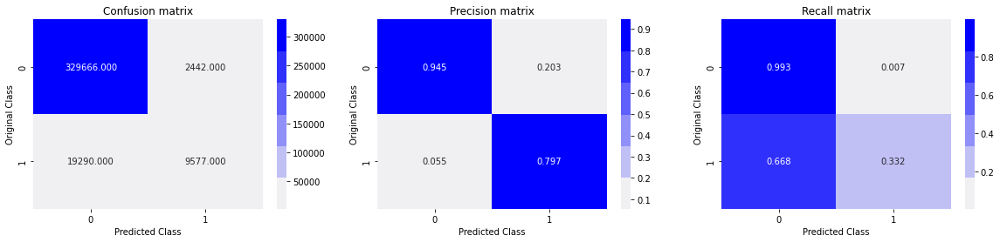

None
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.99      0.97    332108
           1       0.80      0.33      0.47     28867

    accuracy                           0.94    360975
   macro avg       0.87      0.66      0.72    360975
weighted avg       0.93      0.94      0.93    360975

ROC-AUC Score:
0.6622049414655653


In [ ]:
get_all_metrics(y_cv, y_pred)

***Evaluation metric***

In [ ]:
cv_df=dataframe_for_metric_forDL(model4,padded_X_cv_seq)

In [ ]:
cv_df.head()

,id,comment_text,male,female,homosexual_gay_or_lesbian,christian,jewish,muslim,black,white,psychiatric_or_mental_illness,no_of_unique_words,word_count,toxic_words_count,dl_model,target
171378,451469,welcome ignorant like writing eleven mind numb...,False,False,False,False,False,False,False,False,False,9,9,6,0.960022,True
848456,5158745,freeland really want side isis ones killed 80 ...,False,False,False,False,False,False,False,False,False,27,28,25,0.155701,False
844586,5154342,said one greatest not greatest,False,False,False,False,False,False,False,False,False,4,5,4,0.001870,False
994839,5334288,frivolous waste taxpayer time money,False,False,False,False,False,False,False,False,False,5,5,5,0.010220,False
95901,359629,unfortunately natives come across childish wan...,False,False,False,False,False,False,False,False,False,25,28,24,0.123436,False


In [ ]:
bias_metrics_df = compute_bias_metrics_for_model(cv_df, identity_columns, DL_Model_name, TOXICITY_COLUMN)
bias_metrics_df

,subgroup,subgroup_size,subgroup_auc,bpsn_auc,bnsp_auc
2,homosexual_gay_or_lesbian,2167,0.796447,0.730288,0.952688
7,white,5134,0.810814,0.713562,0.961471
6,black,3005,0.815447,0.683055,0.969599
5,muslim,4309,0.831704,0.757201,0.955766
4,jewish,1460,0.848615,0.804294,0.943753
1,female,10587,0.881875,0.846509,0.942801
0,male,8889,0.883350,0.835901,0.948493
8,psychiatric_or_mental_illness,1026,0.892046,0.813401,0.959802
3,christian,8049,0.899661,0.896859,0.921346


In [ ]:
get_final_metric(bias_metrics_df, calculate_overall_auc(cv_df, DL_Model_name))

0.8710112649312134

## **Inferences from DL models results:**



In [ ]:
from tabulate import tabulate
table = [["Input TFIDF-W2V sequence\nWithout Embedding layer (Model1)","0.534","0.777"],
         ["CNN + Embedding layer (Model2)","0.618","0.844"], 
         ["2-LSTM + Embedding layer (Model3)","0.641","0.872"],
         ["2-Bidirectional LSTM + Embedding layer (Model3)","0.662","0.871"]]
headers = ["Model", "ROC-AUC score","Evaluation metric"]
print(tabulate(table, headers, tablefmt="grid"))

+-------------------------------------------------+-----------------+---------------------+
| Model                                           |   ROC-AUC score |   Evaluation metric |
+=================================================+=================+=====================+
| Input TFIDF-W2V sequence                        |           0.534 |               0.777 |
| Without Embedding layer (Model1)                |                 |                     |
+-------------------------------------------------+-----------------+---------------------+
| CNN + Embedding layer (Model2)                  |           0.618 |               0.844 |
+-------------------------------------------------+-----------------+---------------------+
| 2-LSTM + Embedding layer (Model3)               |           0.641 |               0.872 |
+-------------------------------------------------+-----------------+---------------------+
| 2-Bidirectional LSTM + Embedding layer (Model3) |           0.662 |           


*   Model wih input as TFIDF-W2V sequence (Model1) perform better than ML models. With same input but different model, DL models give good results.
*   Model2 and Model3 perform best among all other models, as embedding layers are specifically used on text data, and using pretrained embedding with GloVe vectors.
*   Model2 use CNN-1D layer, that while training finds different patterns in text to classify,so we have got a better final evaluation metric of 0.84 AUC value.
*   Model3 use LSTM , which are on of the best state of art algorithms for sequential data as in our case, so we have got a better final evaluation metric of 0.872 AUC value.
*   Model4 we used Bidirectional LSTM, as to understand the comments in forward as well as in reverse direction, after training we get a final evaluation metric of 0.871 AUC value.





# **Conclusions:**

*   The dataset for our problem is a imbalanced dataset, where classifying data based on toxicity of comments and minimize unintended bias is bigger challenge. 
*   Best tools our used to analyse and visualize our data such as barplots, pie charts , boxplots, wordcloud plots and others.
*   A feature of 'number of unique words in comments' is also added that helps in our analysis.
*   In Data Processing and Cleaning, data is first split in Train and Validation, then removing stop words, html tags, very rare and non-sensical words, decontracting words, Are some of processings methods used. 
*   Vectorizing data with TFIDF-weighted W2V method and Glove vectors, have obtained good vector representations of comments.
*   Training and testing our data on Machine Learning and Deep Learning Models.
*   Considering my computational limits, have trained data on models such as Logistic Regression, Decision Tree and Linear SVM for ML models.
*   Training with DL models like simple feedforward neural network to complex architectures as CNN, LSTM and Bidirectional RNNs give good performance for text classification. 
*   As per the competition evaluation metric, I have obtained a descent final AUC value of 0.87. 










# **Predictions on test Data**

In [ ]:
X_test.head()

,id,comment_text
0,7097320,integrity means pay debts apply president trump
1,7097321,malfeasance administrator board wasting money
2,7097322,rmiller101 spoken like true elitist look bud a...
3,7097323,paul thank kind words indeed strong beliefs no...
4,7097324,sorry missed high school eisenhower sent troop...


In [ ]:
X_test_tokenizer_seq=t_model1.texts_to_sequences(X_test['comment_text'])
padded_X_test_seq=pad_sequences(sequences=X_test_tokenizer_seq,value=0,maxlen=500)
test_predictions=model4.predict(padded_X_test_seq)

In [ ]:
predictions=np.around(test_predictions[:,1], decimals=4)
submission=pd.DataFrame()
submission['id']=X_test['id']
submission['prediction']=predictions
submission.head()

,id,prediction
0,7097320,0.0068
1,7097321,0.0269
2,7097322,0.1652
3,7097323,0.0124
4,7097324,0.0006


**Submission file**

In [ ]:
submission.to_csv('/content/drive/MyDrive/Work_files/Jigsaw_toxicity_classification/submission.csv',index=False)

**Competition Score after submission of the file**

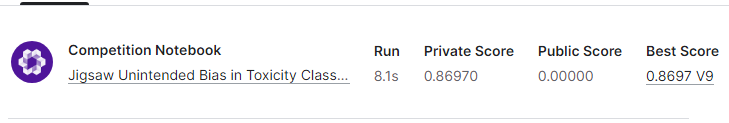